In [178]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns

######
from sklearn.model_selection import train_test_split
######
from sklearn.base import BaseEstimator, TransformerMixin
######
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
######
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
######
from sklearn.pipeline import FeatureUnion
######
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
######
from sklearn.linear_model import SGDRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import LinearSVR
from sklearn.neural_network import MLPRegressor
from sklearn.linear_model import LogisticRegression

from sklearn.ensemble import AdaBoostRegressor, GradientBoostingRegressor, RandomForestRegressor
models = [SGDRegressor(), DecisionTreeRegressor(), LinearSVR(), AdaBoostRegressor(), 
          GradientBoostingRegressor(), RandomForestRegressor(), MLPRegressor()]
######
from sklearn.model_selection import cross_val_predict, cross_val_score, GridSearchCV, RandomizedSearchCV


# Gathering the data (Data Collection)

In [343]:
df = pd.read_excel('/Users/swapnilsrivastava/Desktop/Disseration data/datasets/Projectdata_Raw.xlsx')


In [344]:
df.shape

(19239, 110)

In [12]:
dfs.head(25)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,...,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Messi,"RW, ST, CF",93,93,78000000.0,320000.0,34,...,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000.0,270000.0,32,...,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000.0,270000.0,36,...,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png
3,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Júnior,"LW, CAM",91,91,129000000.0,270000.0,29,...,50+3,50+3,50+3,62+3,20+3,https://cdn.sofifa.net/players/190/871/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,NaN,https://cdn.sofifa.net/flags/br.png
4,192985,https://sofifa.com/player/192985/kevin-de-bruy...,K. De Bruyne,Kevin De Bruyne,"CM, CAM",91,91,125500000.0,350000.0,30,...,69+3,69+3,69+3,75+3,21+3,https://cdn.sofifa.net/players/192/985/22_120.png,https://cdn.sofifa.net/teams/10/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1325/60.png,https://cdn.sofifa.net/flags/be.png
5,200389,https://sofifa.com/player/200389/jan-oblak/220002,J. Oblak,Jan Oblak,GK,91,93,112000000.0,130000.0,28,...,33+3,33+3,33+3,32+3,89+3,https://cdn.sofifa.net/players/200/389/22_120.png,https://cdn.sofifa.net/teams/240/60.png,https://cdn.sofifa.net/flags/es.png,NaN,https://cdn.sofifa.net/flags/si.png
6,231747,https://sofifa.com/player/231747/kylian-mbappe...,K. Mbappé,Kylian Mbappé Lottin,"ST, LW",91,95,194000000.0,230000.0,22,...,54+3,54+3,54+3,63+3,18+3,https://cdn.sofifa.net/players/231/747/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1335/60.png,https://cdn.sofifa.net/flags/fr.png
7,167495,https://sofifa.com/player/167495/manuel-neuer/...,M. Neuer,Manuel Peter Neuer,GK,90,90,13500000.0,86000.0,35,...,34+3,34+3,34+3,35+3,88+2,https://cdn.sofifa.net/players/167/495/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1337/60.png,https://cdn.sofifa.net/flags/de.png
8,192448,https://sofifa.com/player/192448/marc-andre-te...,M. ter Stegen,Marc-André ter Stegen,GK,90,92,99000000.0,250000.0,29,...,33+3,33+3,33+3,31+3,88+3,https://cdn.sofifa.net/players/192/448/22_120.png,https://cdn.sofifa.net/teams/241/60.png,https://cdn.sofifa.net/flags/es.png,NaN,https://cdn.sofifa.net/flags/de.png
9,202126,https://sofifa.com/player/202126/harry-kane/22...,H. Kane,Harry Kane,ST,90,90,129500000.0,240000.0,27,...,61+3,61+3,61+3,64+3,20+3,https://cdn.sofifa.net/players/202/126/22_120.png,https://cdn.sofifa.net/teams/18/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1318/60.png,https://cdn.sofifa.net/flags/gb-eng.png


In [14]:

dfs = dfs.query('league_name == "English Premier League" | league_name == "German 1. Bundesliga" | league_name== "French Ligue 1"')


In [15]:
dfs.head(10)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,...,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Messi,"RW, ST, CF",93,93,78000000.0,320000.0,34,...,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000.0,270000.0,32,...,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000.0,270000.0,36,...,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png
3,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Júnior,"LW, CAM",91,91,129000000.0,270000.0,29,...,50+3,50+3,50+3,62+3,20+3,https://cdn.sofifa.net/players/190/871/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,NaN,https://cdn.sofifa.net/flags/br.png
4,192985,https://sofifa.com/player/192985/kevin-de-bruy...,K. De Bruyne,Kevin De Bruyne,"CM, CAM",91,91,125500000.0,350000.0,30,...,69+3,69+3,69+3,75+3,21+3,https://cdn.sofifa.net/players/192/985/22_120.png,https://cdn.sofifa.net/teams/10/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1325/60.png,https://cdn.sofifa.net/flags/be.png
6,231747,https://sofifa.com/player/231747/kylian-mbappe...,K. Mbappé,Kylian Mbappé Lottin,"ST, LW",91,95,194000000.0,230000.0,22,...,54+3,54+3,54+3,63+3,18+3,https://cdn.sofifa.net/players/231/747/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1335/60.png,https://cdn.sofifa.net/flags/fr.png
7,167495,https://sofifa.com/player/167495/manuel-neuer/...,M. Neuer,Manuel Peter Neuer,GK,90,90,13500000.0,86000.0,35,...,34+3,34+3,34+3,35+3,88+2,https://cdn.sofifa.net/players/167/495/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1337/60.png,https://cdn.sofifa.net/flags/de.png
9,202126,https://sofifa.com/player/202126/harry-kane/22...,H. Kane,Harry Kane,ST,90,90,129500000.0,240000.0,27,...,61+3,61+3,61+3,64+3,20+3,https://cdn.sofifa.net/players/202/126/22_120.png,https://cdn.sofifa.net/teams/18/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1318/60.png,https://cdn.sofifa.net/flags/gb-eng.png
10,215914,https://sofifa.com/player/215914/ngolo-kante/2...,N. Kanté,N'Golo Kanté,"CDM, CM",90,90,100000000.0,230000.0,30,...,84+3,84+3,84+3,85+3,20+3,https://cdn.sofifa.net/players/215/914/22_120.png,https://cdn.sofifa.net/teams/5/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1335/60.png,https://cdn.sofifa.net/flags/fr.png
13,200104,https://sofifa.com/player/200104/heung-min-son...,H. Son,Son Heung-min,"LM, CF, LW",89,89,104000000.0,220000.0,28,...,54+3,54+3,54+3,64+3,19+3,https://cdn.sofifa.net/players/200/104/22_120.png,https://cdn.sofifa.net/teams/18/60.png,https://cdn.sofifa.net/flags/gb-eng.png,NaN,https://cdn.sofifa.net/flags/kr.png


In [16]:
#downloading the df in csv format
dfs.to_excel(r'/Users/swapnilsrivastava/Desktop/newdfexportAug.xlsx', index = False)

In [8]:
dfs = pd.read_excel('/Users/swapnilsrivastava/Desktop/Disseration data/datasets/newdfexportAug.xlsx')


In [9]:
dfs.head(50)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,...,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000,320000,34,...,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000,270000,32,...,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000,270000,36,...,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png
3,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Júnior,"LW, CAM",91,91,129000000,270000,29,...,50+3,50+3,50+3,62+3,20+3,https://cdn.sofifa.net/players/190/871/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,NaN,https://cdn.sofifa.net/flags/br.png
4,192985,https://sofifa.com/player/192985/kevin-de-bruy...,K. De Bruyne,Kevin De Bruyne,"CM, CAM",91,91,125500000,350000,30,...,69+3,69+3,69+3,75+3,21+3,https://cdn.sofifa.net/players/192/985/22_120.png,https://cdn.sofifa.net/teams/10/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1325/60.png,https://cdn.sofifa.net/flags/be.png
5,231747,https://sofifa.com/player/231747/kylian-mbappe...,K. Mbappé,Kylian Mbappé Lottin,"ST, LW",91,95,194000000,230000,22,...,54+3,54+3,54+3,63+3,18+3,https://cdn.sofifa.net/players/231/747/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1335/60.png,https://cdn.sofifa.net/flags/fr.png
6,167495,https://sofifa.com/player/167495/manuel-neuer/...,M. Neuer,Manuel Peter Neuer,GK,90,90,13500000,86000,35,...,34+3,34+3,34+3,35+3,88+2,https://cdn.sofifa.net/players/167/495/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1337/60.png,https://cdn.sofifa.net/flags/de.png
7,202126,https://sofifa.com/player/202126/harry-kane/22...,H. Kane,Harry Kane,ST,90,90,129500000,240000,27,...,61+3,61+3,61+3,64+3,20+3,https://cdn.sofifa.net/players/202/126/22_120.png,https://cdn.sofifa.net/teams/18/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1318/60.png,https://cdn.sofifa.net/flags/gb-eng.png
8,215914,https://sofifa.com/player/215914/ngolo-kante/2...,N. Kanté,N'Golo Kanté,"CDM, CM",90,90,100000000,230000,30,...,84+3,84+3,84+3,85+3,20+3,https://cdn.sofifa.net/players/215/914/22_120.png,https://cdn.sofifa.net/teams/5/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1335/60.png,https://cdn.sofifa.net/flags/fr.png
9,200104,https://sofifa.com/player/200104/heung-min-son...,H. Son,Son Heung-min,"LM, CF, LW",89,89,104000000,220000,28,...,54+3,54+3,54+3,64+3,19+3,https://cdn.sofifa.net/players/200/104/22_120.png,https://cdn.sofifa.net/teams/18/60.png,https://cdn.sofifa.net/flags/gb-eng.png,NaN,https://cdn.sofifa.net/flags/kr.png


In [10]:
dfs.shape

(1780, 110)

# Webscraping Wikipedia count(popularity data)for players

In [8]:
from selenium import webdriver  
from selenium.common.exceptions import NoSuchElementException  
from selenium.webdriver.common.keys import Keys  
from bs4 import BeautifulSoup
import time

In [35]:
#defining a function 
def impute_url(cols):
    name = cols[0]
    url = 'https://pageviews.wmcloud.org/?project=en.wikipedia.org&platform=all-access&agent=user&redirects=0&start=2021-07&end=2022-06&pages=%s'%name 
    return url

In [37]:
dfs['URL'] = dfs[['long_name']].apply(impute_url,axis=1)

In [9]:
resultcount=[]
def impute_Wikipedea(cols):
    url = cols[0]
    browser = webdriver.Chrome(executable_path=r"/Users/swapnilsrivastava/Downloads/chromedriver")
    browser.get(url)  
    time.sleep(5)
    html_source = browser.page_source  
    browser.quit()

    
    soup = BeautifulSoup(html_source,'html.parser') 
    try:
        comments = soup.find_all('span',{'class':'pull-right'})  
        result = (comments[5].text.split('\n')[1].replace(' ',''))
    except IndexError:
        result = '0'
    resultcount.append(result)
    print(result+" "+str(len(resultcount)))
    return resultcount

In [10]:
dfs[['URL']].apply(impute_Wikipedea,axis=1)

/var/folders/_y/xn3ctgpx2kq_z25wf8cn757r0000gn/T/ipykernel_56946/1726364060.py:4: DeprecationWarning: executable_path has been deprecated, please pass in a Service object
  browser = webdriver.Chrome(executable_path=r"/Users/swapnilsrivastava/Downloads/chromedriver")


16 1
264,938 2
46 3
35 4
135,087 5
4 6
3 7
326,786 8
105,863 9
156,872 10
115,004 11
0 12
4 13
19 14
3 15
0 16
56,438 17
7 18
0 19
0 20
119,728.5 21
79 22
532 23
39,929 24
0 25
86,652 26
161,832 27
51,245 28
30 29
1 30
55,179 31
90,084 32
95,801.5 33
2 34
25,340 35
0 36
3,805 37
52,357.5 38
76,501 39
107,829 40
9 41
4 42
44,865 43
1 44
3.5 45
31 46
2 47
99 48
11,358.5 49
4 50
10,281 51
48,503 52
49,862 53
66,387 54
2 55
6 56
0 57
2 58
2 59
156,434 60
2 61
50,496 62
94,252 63
0 64
25,859 65
19,305 66
0 67
163,520 68
24,368 69
33,438 70
115,349 71
8,365 72
14,243 73
56,036 74
2 75
58 76
65,388 77
30,575 78
2 79
1 80
9 81
4 82
37 83
21,502 84
47,814 85
2 86
5,921 87
20,820 88
0 89
46 90
7,906 91
0 92
45,156 93
269 94
2 95
32,818 96
97,683 97
40,375 98
33,316 99
5 100
8,611 101
0 102
0 103
36,203 104
28,264 105
37,439 106
8 107
118,205 108
95,591 109
20,830 110
0 111
20,773 112
34,027 113
53,272 114
135 115
2,718 116
57,268 117
5,271 118
23,230 119
2 120
22,684 121
3 122
11,988.5 123
25,44

1 964
559 965
0 966
713 967
1,664 968
395 969
311 970
7,698 971
32 972
935 973
3 974
7,543 975
1,141 976
332 977
366 978
1,351 979
823 980
0 981
255 982
8,789 983
522 984
645 985
55 986
283 987
0 988
1,186 989
0 990
28 991
696 992
845 993
857 994
6,590 995
592 996
1 997
269 998
10,711 999
246 1000
666 1001
3,565 1002
0 1003
0 1004
716 1005
1 1006
1 1007
2 1008
223.5 1009
4.5 1010
311 1011
20,969 1012
0 1013
291 1014
13,140 1015
499 1016
1 1017
1,287 1018
931 1019
895.5 1020
2,131 1021
1,345 1022
3 1023
31,773 1024
0 1025
3.5 1026
8 1027
0 1028
250 1029
1 1030
8,290 1031
15,066 1032
1,834 1033
10,629 1034
456 1035
1,079 1036
11,547 1037
602 1038
142 1039
7,235 1040
8,066 1041
860 1042
11,980 1043
54 1044
1,809 1045
858 1046
819 1047
214 1048
244 1049
0 1050
22,785 1051
6,609 1052
153 1053
853 1054
2,473 1055
7,524 1056
2,747 1057
429 1058
1,324 1059
1 1060
200 1061
57 1062
37 1063
993 1064
0 1065
1,441 1066
25,699 1067
146 1068
648 1069
1,729 1070
824 1071
162 1072
5,704 1073
0 1074
638

0       [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
1       [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
2       [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
3       [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
4       [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
                              ...                        
1775    [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
1776    [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
1777    [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
1778    [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
1779    [16, 264,938, 46, 35, 135,087, 4, 3, 326,786, ...
Length: 1780, dtype: object

In [12]:
len(resultcount)

1780

In [14]:
resultcount

['16',
 '264,938',
 '46',
 '35',
 '135,087',
 '4',
 '3',
 '326,786',
 '105,863',
 '156,872',
 '115,004',
 '0',
 '4',
 '19',
 '3',
 '0',
 '56,438',
 '7',
 '0',
 '0',
 '119,728.5',
 '79',
 '532',
 '39,929',
 '0',
 '86,652',
 '161,832',
 '51,245',
 '30',
 '1',
 '55,179',
 '90,084',
 '95,801.5',
 '2',
 '25,340',
 '0',
 '3,805',
 '52,357.5',
 '76,501',
 '107,829',
 '9',
 '4',
 '44,865',
 '1',
 '3.5',
 '31',
 '2',
 '99',
 '11,358.5',
 '4',
 '10,281',
 '48,503',
 '49,862',
 '66,387',
 '2',
 '6',
 '0',
 '2',
 '2',
 '156,434',
 '2',
 '50,496',
 '94,252',
 '0',
 '25,859',
 '19,305',
 '0',
 '163,520',
 '24,368',
 '33,438',
 '115,349',
 '8,365',
 '14,243',
 '56,036',
 '2',
 '58',
 '65,388',
 '30,575',
 '2',
 '1',
 '9',
 '4',
 '37',
 '21,502',
 '47,814',
 '2',
 '5,921',
 '20,820',
 '0',
 '46',
 '7,906',
 '0',
 '45,156',
 '269',
 '2',
 '32,818',
 '97,683',
 '40,375',
 '33,316',
 '5',
 '8,611',
 '0',
 '0',
 '36,203',
 '28,264',
 '37,439',
 '8',
 '118,205',
 '95,591',
 '20,830',
 '0',
 '20,773',
 '34,

In [15]:
dfs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1780 entries, 0 to 1779
Columns: 111 entries, sofifa_id to URL
dtypes: datetime64[ns](2), float64(10), int64(50), object(49)
memory usage: 1.5+ MB


In [16]:
r = resultcount[0:1780]

In [17]:
wikipedia_views = pd.DataFrame(r,columns=['Wikipedia_Views'])


In [20]:
wikipedia_views.head(50)

,Wikipedia_Views
0,16
1,"264,938"
2,46
3,35
4,"135,087"
5,4
6,3
7,"326,786"
8,"105,863"
9,"156,872"


In [21]:
dfs = pd.concat([dfs,wikipedia_views],axis=1)


In [22]:
dfs.head(30)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,...,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,URL,Wikipedia_Views
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000,320000,34,...,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,16
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000,270000,32,...,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,https://pageviews.wmcloud.org/?project=en.wiki...,"264,938"
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000,270000,36,...,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png,https://pageviews.wmcloud.org/?project=en.wiki...,46
3,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Júnior,"LW, CAM",91,91,129000000,270000,29,...,50+3,62+3,20+3,https://cdn.sofifa.net/players/190/871/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,NaN,https://cdn.sofifa.net/flags/br.png,https://pageviews.wmcloud.org/?project=en.wiki...,35
4,192985,https://sofifa.com/player/192985/kevin-de-bruy...,K. De Bruyne,Kevin De Bruyne,"CM, CAM",91,91,125500000,350000,30,...,69+3,75+3,21+3,https://cdn.sofifa.net/players/192/985/22_120.png,https://cdn.sofifa.net/teams/10/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1325/60.png,https://cdn.sofifa.net/flags/be.png,https://pageviews.wmcloud.org/?project=en.wiki...,"135,087"
5,231747,https://sofifa.com/player/231747/kylian-mbappe...,K. Mbappé,Kylian Mbappé Lottin,"ST, LW",91,95,194000000,230000,22,...,54+3,63+3,18+3,https://cdn.sofifa.net/players/231/747/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1335/60.png,https://cdn.sofifa.net/flags/fr.png,https://pageviews.wmcloud.org/?project=en.wiki...,4
6,167495,https://sofifa.com/player/167495/manuel-neuer/...,M. Neuer,Manuel Peter Neuer,GK,90,90,13500000,86000,35,...,34+3,35+3,88+2,https://cdn.sofifa.net/players/167/495/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1337/60.png,https://cdn.sofifa.net/flags/de.png,https://pageviews.wmcloud.org/?project=en.wiki...,3
7,202126,https://sofifa.com/player/202126/harry-kane/22...,H. Kane,Harry Kane,ST,90,90,129500000,240000,27,...,61+3,64+3,20+3,https://cdn.sofifa.net/players/202/126/22_120.png,https://cdn.sofifa.net/teams/18/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1318/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://pageviews.wmcloud.org/?project=en.wiki...,"326,786"
8,215914,https://sofifa.com/player/215914/ngolo-kante/2...,N. Kanté,N'Golo Kanté,"CDM, CM",90,90,100000000,230000,30,...,84+3,85+3,20+3,https://cdn.sofifa.net/players/215/914/22_120.png,https://cdn.sofifa.net/teams/5/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1335/60.png,https://cdn.sofifa.net/flags/fr.png,https://pageviews.wmcloud.org/?project=en.wiki...,"105,863"
9,200104,https://sofifa.com/player/200104/heung-min-son...,H. Son,Son Heung-min,"LM, CF, LW",89,89,104000000,220000,28,...,54+3,64+3,19+3,https://cdn.sofifa.net/players/200/104/22_120.png,

In [23]:
dfs.to_excel(r'/Users/swapnilsrivastava/Desktop/FinalDataset.xlsx', index = False)

In [24]:
wikipedia_views.to_excel(r'/Users/swapnilsrivastava/Desktop/wikiviews.xlsx', index = False)

In [38]:
dfs.head(100)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,...,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,URL,Wikipedia_Views
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000,320000,34,...,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,16
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000,270000,32,...,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,https://pageviews.wmcloud.org/?project=en.wiki...,"264,938"
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000,270000,36,...,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png,https://pageviews.wmcloud.org/?project=en.wiki...,46
3,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Júnior,"LW, CAM",91,91,129000000,270000,29,...,50+3,62+3,20+3,https://cdn.sofifa.net/players/190/871/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,NaN,https://cdn.sofifa.net/flags/br.png,https://pageviews.wmcloud.org/?project=en.wiki...,35
4,192985,https://sofifa.com/player/192985/kevin-de-bruy...,K. De Bruyne,Kevin De Bruyne,"CM, CAM",91,91,125500000,350000,30,...,69+3,75+3,21+3,https://cdn.sofifa.net/players/192/985/22_120.png,https://cdn.sofifa.net/teams/10/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1325/60.png,https://cdn.sofifa.net/flags/be.png,https://pageviews.wmcloud.org/?project=en.wiki...,"135,087"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,204935,https://sofifa.com/player/204935/jordan-pickfo...,J. Pickford,Jordan Pickford,GK,83,85,33000000,83000,27,...,34+3,33+3,82+3,https://cdn.sofifa.net/players/204/935/22_120.png,https://cdn.sofifa.net/teams/7/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1318/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://pageviews.wmcloud.org/?project=en.wiki...,"32,818"
96,205452,https://sofifa.com/player/205452/antonio-rudig...,A. Rüdiger,Antonio Rüdiger,CB,83,84,34500000,130000,28,...,83+1,78+2,20+2,https://cdn.sofifa.net/players/205/452/22_120.png,https://cdn.sofifa.net/teams/5/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1337/60.png,https://cdn.sofifa.net/flags/de.png,https://pageviews.wmcloud.org/?project=en.wiki...,"97,683"
97,207410,https://sofifa.com/player/207410/mateo-kovacic...,M. Kovačić,Mateo Kovačić,"CM, CDM",83,84,41500000,135000,27,...,70+3,74+3,15+3,https://cdn.sofifa.net/players/207/410/22_120.png,https://cdn.sofifa.net/teams/5/60.png,https://cdn.sofifa.net/flags/gb-eng.png,NaN,https://cdn.sofifa.net/flags/hr.png,https://pageviews.wmcloud.org/?project=en.wiki...,"40,375"
98,209989,https://sofifa.com/player/209989/thomas-partey...,T. Partey,Thomas Partey,"CM, CDM",83,83,36500000,115000,28,...,81+2,79+2,18+2,https://cdn.sofifa.net/players/209/989/22_120.png,https://cdn.sofifa.net/teams/1/60.png,https://cdn.sofifa.net/flags/gb-eng.png,NaN,https://cdn.sofifa.net/flags/gh.png,https://pageviews.wmcloud.org/?project=en.wiki...,"33,316"


#The above scraping gave wrong Wiki_view for 666 players because the Wiki_view output was either 0 or very low<br>
<br>
#666 wrong scraping was done because player's long_name mentioned in the dataset was not matching with wikipedia names  of the players<br>
<br>
#To correct the names in the dataset- manually changed the player's long_name of the 666 players and named them according to wikipedia page<br>
<br>
#Performed scraping for those 666 players and then merged the new data in the original dataset<br>
<br>
The below code is for scraping wiki_view for those 666 players

In [6]:
dfs.shape

(1780, 111)

In [2]:
import pandas as pd

In [3]:
dfwikiview = pd.read_excel('/Users/swapnilsrivastava/Desktop/Disseration data/wikiviewmissingvalues.xlsx')


In [4]:
dfwikiview.head(50)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,...,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,URL,Wikipedia_Views
0,208722,https://sofifa.com/player/208722/sadio-mane/22...,S. Mané,Sadio Mane,LW,89,89,101000000,270000,29,...,59+3,65+3,19+3,https://cdn.sofifa.net/players/208/722/22_120.png,https://cdn.sofifa.net/teams/9/60.png,https://cdn.sofifa.net/flags/gb-eng.png,NaN,https://cdn.sofifa.net/flags/sn.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0
1,212831,https://sofifa.com/player/212831/alisson-ramse...,Alisson,Alisson Becker,GK,89,90,82000000,190000,28,...,31+3,30+3,87+3,https://cdn.sofifa.net/players/212/831/22_120.png,https://cdn.sofifa.net/teams/9/60.png,https://cdn.sofifa.net/flags/gb-eng.png,NaN,https://cdn.sofifa.net/flags/br.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0
2,192505,https://sofifa.com/player/192505/romelu-lukaku...,R. Lukaku,Romelu Lukaku,ST,88,88,93500000,260000,28,...,57+3,58+3,19+3,https://cdn.sofifa.net/players/192/505/22_120.png,https://cdn.sofifa.net/teams/5/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1325/60.png,https://cdn.sofifa.net/flags/be.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0
3,193041,https://sofifa.com/player/193041/keylor-navas/...,K. Navas,Keylor Navas,GK,88,88,15500000,130000,34,...,32+3,31+3,86+2,https://cdn.sofifa.net/players/193/041/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,NaN,https://cdn.sofifa.net/flags/cr.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0
4,183898,https://sofifa.com/player/183898/angel-di-mari...,Á. Di María,Ángel Di María,"RW, LW",87,87,49500000,160000,33,...,58+3,67+3,18+3,https://cdn.sofifa.net/players/183/898/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0
5,189509,https://sofifa.com/player/189509/thiago-alcant...,Thiago,Thiago Alcântara,"CM, CDM",86,86,65000000,180000,30,...,71+3,75+3,18+3,https://cdn.sofifa.net/players/189/509/22_120.png,https://cdn.sofifa.net/teams/9/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1362/60.png,https://cdn.sofifa.net/flags/es.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0
6,205498,https://sofifa.com/player/205498/luiz-frello-f...,Jorginho,Jorginho,"CM, CDM",85,85,52500000,170000,29,...,73+2,76+2,19+2,https://cdn.sofifa.net/players/205/498/22_120.png,https://cdn.sofifa.net/teams/5/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1343/60.png,https://cdn.sofifa.net/flags/it.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0
7,193080,https://sofifa.com/player/193080/david-de-gea-...,De Gea,David de Gea,GK,84,84,28000000,120000,30,...,34+3,35+3,82+2,https://cdn.sofifa.net/players/193/080/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1362/60.png,https://cdn.sofifa.net/flags/es.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0
8,202811,https://sofifa.com/player/202811/emiliano-mart...,E. Martínez,Emiliano Martínez,GK,84,85,33500000,81000,28,...,32+3,33+3,83+2,https://cdn.sofifa.net/players/202/811/22_120.png,https://cdn.sofifa.net/teams/2/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0
9,197061,https://sofifa.com/player/197061/joel-matip/22...,J. Matip,Joël Matip,CB,83,83,30500000,130000,29,...,83,76+2,19+2,https://cdn.sofifa.net/players/197/061/22_120.png,https://cdn.sofifa.net/teams/9/60.png,https://cdn.sofifa.net/flags/gb-eng.png,NaN,https://cdn.sofifa.net/flags/cm.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0


In [6]:
import numpy as np


In [13]:
def impute_url(cols):
    name = cols[0]
    url = 'https://pageviews.wmcloud.org/?project=en.wikipedia.org&platform=all-access&agent=user&redirects=0&start=2021-07&end=2022-06&pages=%s'%name 
    return url

In [14]:
dfwikiview['URL'] = dfwikiview[['long_name']].apply(impute_url,axis=1)


In [15]:
from selenium import webdriver  
from selenium.common.exceptions import NoSuchElementException  
from selenium.webdriver.common.keys import Keys  
from bs4 import BeautifulSoup
import time

In [16]:
resultcount=[]
def impute_Wikipedea(cols):
    url = cols[0]
    browser = webdriver.Chrome(executable_path=r"/Users/swapnilsrivastava/Downloads/chromedriver")
    browser.get(url)  
    time.sleep(5)
    html_source = browser.page_source  
    browser.quit()

    
    soup = BeautifulSoup(html_source,'html.parser') 
    try:
        comments = soup.find_all('span',{'class':'pull-right'})  
        result = (comments[5].text.split('\n')[1].replace(' ',''))
    except IndexError:
        result = '0'
    resultcount.append(result)
    print(result+" "+str(len(resultcount)))
    return resultcount

In [17]:
dfwikiview[['URL']].apply(impute_Wikipedea,axis=1)

/var/folders/_y/xn3ctgpx2kq_z25wf8cn757r0000gn/T/ipykernel_6437/1726364060.py:4: DeprecationWarning: executable_path has been deprecated, please pass in a Service object
  browser = webdriver.Chrome(executable_path=r"/Users/swapnilsrivastava/Downloads/chromedriver")


1,366 1
797 2
200,295 3
52,030 4
91,359 5
101,838 6
884 7
74,038 8
38,328.5 9
55,022 10
62,602 11
11,088 12
39,138 13
3,321 14
26,377 15
5,219 16
6,347 17
6,654 18
7,656 19
10,643.5 20
11,294 21
1,394 22
13,985 23
10,623 24
5,798 25
10,757 26
142 27
19,216 28
9,174 29
11,543 30
2,409 31
10,228 32
3,002 33
1,808 34
2,215 35
6,324 36
33,037 37
223 38
4,223 39
3,917 40
2,582 41
7,829 42
0 43
9,243 44
10,497 45
1,774 46
2,376 47
15,705 48
3,562 49
46 50
3,086 51
30,219 52
12,560 53
4,889 54
738 55
3,394 56
2,239 57
682 58
25 59
701 60
2,519 61
42,606 62
1,459 63
66,808 64
2,577 65
2,160 66
5,752 67
3,072 68
811 69
802 70
2,687.5 71
9,566 72
3,481 73
9,252 74
2,235 75
1,509 76
3,678 77
13,899 78
1,855 79
28,227 80
14 81
22,396 82
3,036.5 83
2,399 84
1,612 85
3,875 86
35 87
3,049 88
763 89
5,477 90
2,788 91
792 92
1,040 93
10,656 94
18 95
3,871 96
3,382 97
2,505 98
6,562 99
413 100
8,772 101
7,960 102
1,104 103
1,898 104
4,863 105
3,857 106
7,099 107
12,425 108
11,746 109
2,576 110
1,645 111

TimeoutException: Message: timeout: Timed out receiving message from renderer: 300.000
  (Session info: chrome=104.0.5112.79)
Stacktrace:
0   chromedriver                        0x000000010eecdef9 chromedriver + 4480761
1   chromedriver                        0x000000010ee595d3 chromedriver + 4003283
2   chromedriver                        0x000000010eaec338 chromedriver + 410424
3   chromedriver                        0x000000010ead82ec chromedriver + 328428
4   chromedriver                        0x000000010ead70c6 chromedriver + 323782
5   chromedriver                        0x000000010ead75fc chromedriver + 325116
6   chromedriver                        0x000000010eae46af chromedriver + 378543
7   chromedriver                        0x000000010eae5212 chromedriver + 381458
8   chromedriver                        0x000000010eaf38c3 chromedriver + 440515
9   chromedriver                        0x000000010eaf774a chromedriver + 456522
10  chromedriver                        0x000000010ead792e chromedriver + 325934
11  chromedriver                        0x000000010eaf364d chromedriver + 439885
12  chromedriver                        0x000000010eb523ef chromedriver + 828399
13  chromedriver                        0x000000010eb3f953 chromedriver + 751955
14  chromedriver                        0x000000010eb15cd5 chromedriver + 580821
15  chromedriver                        0x000000010eb16d25 chromedriver + 584997
16  chromedriver                        0x000000010ee9f02d chromedriver + 4288557
17  chromedriver                        0x000000010eea41b3 chromedriver + 4309427
18  chromedriver                        0x000000010eea923f chromedriver + 4330047
19  chromedriver                        0x000000010eea4dfa chromedriver + 4312570
20  chromedriver                        0x000000010ee7dfef chromedriver + 4153327
21  chromedriver                        0x000000010eebed78 chromedriver + 4418936
22  chromedriver                        0x000000010eebeeff chromedriver + 4419327
23  chromedriver                        0x000000010eed5ab5 chromedriver + 4512437
24  libsystem_pthread.dylib             0x00007fff67695109 _pthread_start + 148
25  libsystem_pthread.dylib             0x00007fff67690b8b thread_start + 15


In [19]:
len(resultcount)

627

In [21]:
dfwikiview.loc[626:][['URL']].apply(impute_Wikipedea,axis=1)


/var/folders/_y/xn3ctgpx2kq_z25wf8cn757r0000gn/T/ipykernel_6437/1726364060.py:4: DeprecationWarning: executable_path has been deprecated, please pass in a Service object
  browser = webdriver.Chrome(executable_path=r"/Users/swapnilsrivastava/Downloads/chromedriver")


22 628
22 629
22 630
23 631
24 632
25 633
25 634
728.5 635
27.5 636
28,926 637
28 638
38,991 639
537 640
31 641
1,429 642
32 643
357,405 644
35 645
35 646
35 647
35 648
35 649
36 650
429 651
37 652
37 653
22,896 654
38 655
39 656
40 657
41 658
226 659
42 660
29,168 661
45 662
1,642,013 663
7 664
46 665
47 666


626    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
627    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
628    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
629    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
630    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
631    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
632    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
633    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
634    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
635    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
636    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
637    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
638    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
639    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
640    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
641    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
642    [1,366, 797, 200,295, 52,030, 91,359, 101,838,...
643    [1,366, 797, 200,295, 52

In [24]:
len(resultcount)

666

In [25]:
r = resultcount[0:666]

In [26]:
wikipedia_views = pd.DataFrame(r,columns=['Wikipedia_Views'])


In [27]:
wikipedia_views.head(50)

,Wikipedia_Views
0,"1,366"
1,797
2,"200,295"
3,"52,030"
4,"91,359"
5,"101,838"
6,884
7,"74,038"
8,"38,328.5"
9,"55,022"


In [28]:
dfwikiview = pd.concat([dfwikiview,wikipedia_views],axis=1)


In [30]:
dfwikiview.head(30)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,...,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,URL,Wikipedia_Views,Wikipedia_Views
0,208722.0,https://sofifa.com/player/208722/sadio-mane/22...,S. Mané,Sadio Mane,LW,89.0,89.0,101000000.0,270000.0,29.0,...,65+3,19+3,https://cdn.sofifa.net/players/208/722/22_120.png,https://cdn.sofifa.net/teams/9/60.png,https://cdn.sofifa.net/flags/gb-eng.png,NaN,https://cdn.sofifa.net/flags/sn.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0,"1,366"
1,212831.0,https://sofifa.com/player/212831/alisson-ramse...,Alisson,Alisson Becker,GK,89.0,90.0,82000000.0,190000.0,28.0,...,30+3,87+3,https://cdn.sofifa.net/players/212/831/22_120.png,https://cdn.sofifa.net/teams/9/60.png,https://cdn.sofifa.net/flags/gb-eng.png,NaN,https://cdn.sofifa.net/flags/br.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0,797
2,192505.0,https://sofifa.com/player/192505/romelu-lukaku...,R. Lukaku,Romelu Lukaku,ST,88.0,88.0,93500000.0,260000.0,28.0,...,58+3,19+3,https://cdn.sofifa.net/players/192/505/22_120.png,https://cdn.sofifa.net/teams/5/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1325/60.png,https://cdn.sofifa.net/flags/be.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0,"200,295"
3,193041.0,https://sofifa.com/player/193041/keylor-navas/...,K. Navas,Keylor Navas,GK,88.0,88.0,15500000.0,130000.0,34.0,...,31+3,86+2,https://cdn.sofifa.net/players/193/041/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,NaN,https://cdn.sofifa.net/flags/cr.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0,"52,030"
4,183898.0,https://sofifa.com/player/183898/angel-di-mari...,Á. Di María,Ángel Di María,"RW, LW",87.0,87.0,49500000.0,160000.0,33.0,...,67+3,18+3,https://cdn.sofifa.net/players/183/898/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0,"91,359"
5,189509.0,https://sofifa.com/player/189509/thiago-alcant...,Thiago,Thiago Alcântara,"CM, CDM",86.0,86.0,65000000.0,180000.0,30.0,...,75+3,18+3,https://cdn.sofifa.net/players/189/509/22_120.png,https://cdn.sofifa.net/teams/9/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1362/60.png,https://cdn.sofifa.net/flags/es.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0,"101,838"
6,205498.0,https://sofifa.com/player/205498/luiz-frello-f...,Jorginho,Jorginho,"CM, CDM",85.0,85.0,52500000.0,170000.0,29.0,...,76+2,19+2,https://cdn.sofifa.net/players/205/498/22_120.png,https://cdn.sofifa.net/teams/5/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1343/60.png,https://cdn.sofifa.net/flags/it.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0,884
7,193080.0,https://sofifa.com/player/193080/david-de-gea-...,De Gea,David de Gea,GK,84.0,84.0,28000000.0,120000.0,30.0,...,35+3,82+2,https://cdn.sofifa.net/players/193/080/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1362/60.png,https://cdn.sofifa.net/flags/es.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0,"74,038"
8,202811.0,https://sofifa.com/player/202811/emiliano-mart...,E. Martínez,Emiliano Martínez,GK,84.0,85.0,33500000.0,81000.0,28.0,...,33+3,83+2,https://cdn.sofifa.net/players/202/811/22_120.png,https://cdn.sofifa.net/teams/2/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,0.0,"38,328.5"
9,197061.0,https://sofifa.com/player/197061/joel-matip/22...,J. Matip,Joël Matip,CB,83.0,83.0,30500000.0,130000.0,29.0,...,76+2,19+2,https://cdn.sofifa.net/players/197/061/22_120.png,https://cdn.sofifa.net/teams/9/60.png,https://cdn.sofifa.net/

In [31]:
dfwikiview.to_excel(r'/Users/swapnilsrivastava/Desktop/zerowikiviewDataset.xlsx', index = False)

###### reading the final dataset after scraping again the player's wikipedia view count for the 666 players whose counts were not scraped correctly and then merging it with the original dataset in the excel file

In [1470]:
finaldf = pd.read_excel('/Users/swapnilsrivastava/Desktop/Disseration data/datasets/FinalDataset.xlsx')

### Gathering wage data for players for the year 2020 and 2021

In [1471]:
finaldfmerge_21 = pd.read_excel('/Users/swapnilsrivastava/Desktop/Disseration data/datasets/players_21.xlsx')

In [1472]:
finaldfmerge_20 = pd.read_excel('/Users/swapnilsrivastava/Desktop/Disseration data/datasets/players_20.xlsx')

In [214]:
pd.set_option('display.max_columns', None)

In [1473]:
finaldf=pd.merge(finaldf, finaldfmerge_21, on=['sofifa_id'],how='left')

In [1474]:
finaldf=pd.merge(finaldf, finaldfmerge_20, on=['sofifa_id'],how='left')

In [1475]:
finaldf.head()

,sofifa_id,player_url,short_name,long_name_x,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,URL,Wikipedia_Views,long_name_y,wage_eur_21,long_name,wage_eur_20
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000,320000,34,1987-06-24,170,72,73,Paris Saint-Germain,French Ligue 1,1,RW,30,NaN,2021-08-10,2023,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93+1,93+1,93+-1,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,"1,072,960",Lionel Andrés Messi Cuccittini,560000.0,Lionel Andrés Messi Cuccittini,575000.0
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000,270000,32,1988-08-21,185,81,21,FC Bayern München,German 1. Bundesliga,1,ST,9,NaN,2014-07-01,2023,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,https://pageviews.wmcloud.org/?project=en.wiki...,"264,938",Robert Lewandowski,240000.0,Robert Lewandowski,225000.0
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000,270000,36,1985-02-05,187,83,11,Manchester United,English Premier League,1,ST,7,NaN,2021-08-27,2023,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,

In [1476]:
finaldf.drop(['long_name', 'long_name_y'], axis=1, inplace=True)

In [1477]:
finaldf.rename(columns={'long_name_x': 'long_name'}, inplace=True)


In [225]:
finaldf.head()

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,URL,Wikipedia_Views,wage_avg
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000,320000,34,1987-06-24,170,72,73,Paris Saint-Germain,French Ligue 1,1,RW,30,NaN,2021-08-10,2023,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93+1,93+1,93+-1,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,"1,072,960",78000000.0
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000,270000,32,1988-08-21,185,81,21,FC Bayern München,German 1. Bundesliga,1,ST,9,NaN,2014-07-01,2023,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,https://pageviews.wmcloud.org/?project=en.wiki...,"264,938",119500000.0
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000,270000,36,1985-02-05,187,83,11,Manchester United,English Premier League,1,ST,7,NaN,2021-08-27,2023,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.pn

In [ ]:
#Calculating average wage of last three years and creating a new column 'wage_avg'

In [1478]:
finaldf['wage_avg'] = finaldf[['wage_eur', 'wage_eur_21', 'wage_eur_20']].mean(axis=1)

In [219]:
finaldf.head()

,sofifa_id,player_url,short_name,long_name_x,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,URL,Wikipedia_Views,long_name_y,wage_eur_21,long_name,wage_eur_20,wage_avg
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000,320000,34,1987-06-24,170,72,73,Paris Saint-Germain,French Ligue 1,1,RW,30,NaN,2021-08-10,2023,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93+1,93+1,93+-1,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,"1,072,960",Lionel Andrés Messi Cuccittini,560000.0,Lionel Andrés Messi Cuccittini,575000.0,485000.000000
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000,270000,32,1988-08-21,185,81,21,FC Bayern München,German 1. Bundesliga,1,ST,9,NaN,2014-07-01,2023,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,https://pageviews.wmcloud.org/?project=en.wiki...,"264,938",Robert Lewandowski,240000.0,Robert Lewandowski,225000.0,245000.000000
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000,270000,36,1985-02-05,187,83,11,Manchester United,English Premier League,1,ST,7,NaN,2021-08-27,2023,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,

In [1479]:
finaldf.drop(['wage_eur_21', 'wage_eur_20'], axis=1, inplace=True)

In [1480]:
finaldf["wage_avg"] = round(finaldf["value_eur"].astype(float),0)

In [1481]:
finaldf.head()

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,URL,Wikipedia_Views,wage_avg
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000,320000,34,1987-06-24,170,72,73,Paris Saint-Germain,French Ligue 1,1,RW,30,NaN,2021-08-10,2023,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93+1,93+1,93+-1,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,"1,072,960",78000000.0
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000,270000,32,1988-08-21,185,81,21,FC Bayern München,German 1. Bundesliga,1,ST,9,NaN,2014-07-01,2023,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,https://pageviews.wmcloud.org/?project=en.wiki...,"264,938",119500000.0
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000,270000,36,1985-02-05,187,83,11,Manchester United,English Premier League,1,ST,7,NaN,2021-08-27,2023,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.pn

## Data Pre-processing to make it into machine-readable form

In [227]:
finaldf.head()

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,URL,Wikipedia_Views,wage_avg
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000,320000,34,1987-06-24,170,72,73,Paris Saint-Germain,French Ligue 1,1,RW,30,NaN,2021-08-10,2023,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93+1,93+1,93+-1,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,https://pageviews.wmcloud.org/?project=en.wiki...,"1,072,960",78000000.0
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000,270000,32,1988-08-21,185,81,21,FC Bayern München,German 1. Bundesliga,1,ST,9,NaN,2014-07-01,2023,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,https://pageviews.wmcloud.org/?project=en.wiki...,"264,938",119500000.0
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000,270000,36,1985-02-05,187,83,11,Manchester United,English Premier League,1,ST,7,NaN,2021-08-27,2023,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.pn

In [228]:
finaldf.shape

(1780, 113)

In [1482]:
finaldf.to_excel(r'/Users/swapnilsrivastava/Desktop/Final_merged.xlsx', index = False)


In [ ]:
finaldf = pd.read_excel('/Users/swapnilsrivastava/Desktop/Disseration data/datasets/players_21.xlsx')

###### Data Cleaning<br>
#apply more data-science related data preparation steps such as handling nulls, fixing skewed features, etc.<br>
#null values handling

In [229]:

def null_counts(df):
    for col in df.columns:
        print(f"{col} : {df[col].isnull().sum()}")
null_counts(finaldf)

sofifa_id : 0
player_url : 0
short_name : 0
long_name : 0
player_positions : 0
overall : 0
potential : 0
value_eur : 0
wage_eur : 0
age : 0
dob : 0
height_cm : 0
weight_kg : 0
club_team_id : 0
club_name : 0
league_name : 0
league_level : 0
club_position : 0
club_jersey_number : 0
club_loaned_from : 1694
club_joined : 86
club_contract_valid_until : 0
nationality_id : 0
nationality_name : 0
nation_team_id : 1550
nation_position : 1550
nation_jersey_number : 1550
preferred_foot : 0
weak_foot : 0
skill_moves : 0
international_reputation : 0
work_rate : 0
body_type : 0
real_face : 0
release_clause_eur : 86
player_tags : 1503
player_traits : 656
pace : 202
shooting : 202
passing : 202
dribbling : 202
defending : 202
physic : 202
Passing_crossing : 0
shooting_finishing : 0
defending_heading_accuracy : 0
passing_short_passing : 0
shooting_volleys : 0
dribbling_dribbling : 0
passing_curve : 0
passing_fk_accuracy : 0
passing_long_passing : 0
dribbling_ball_control : 0
pace_acceleration : 0
pace_

In [230]:
#Removing the attributes that are not relevant for modelling: Removing 22 columns

finaldf.drop(['player_url' ,'short_name' ,'player_positions' ,'player_face_url' ,'club_logo_url' ,'club_flag_url' ,'nation_logo_url' ,'nation_flag_url' ,'URL' ,'club_name' ,'club_jersey_number','nation_jersey_number', 'real_face' ,'player_tags','player_traits', 'club_loaned_from', 'club_joined', 'nationality_name', 'nation_team_id', 'nation_position', 'dob', 'league_level'], axis=1, inplace=True)


In [231]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_name,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,Wikipedia_Views,wage_avg
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,French Ligue 1,RW,2023,52,Left,4,4,5,Medium/Low,Unique,144300000.0,85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93+1,93+1,93+-1,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,"1,072,960",78000000.0
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,German 1. Bundesliga,ST,2023,37,Right,4,4,5,High/Medium,Unique,197200000.0,78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,"264,938",119500000.0
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,English Premier League,ST,2023,38,Right,4,5,5,High/Low,Unique,83300000.0,87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,"1,642,013",45000000.0
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,French Ligue 1,ST,2022,18,Right,4,5,4,High/Low,Unique,373500000.0,97.0,88.0,80.0,92.0,36.0,77.0,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,NaN,83+3,83+3,83+3,90,90,90,90,90,89+2,89+2,89+2,89+2,82+3,82+3,82+3,89+2,67+3,63+3,63+3,63+3,67+3,62+3,50+3,50+3,50+3,62+3,20+3,"307,816",194000000.0
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,English Premier League,RCM,2025,7,Right,5,4,4,High/High,Unique,232200000.0,76.0,86.0,93.0,88.0,64.0,78.0,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN,83+3,83+3,83+3,88,87,87,87,88,89+2,89+2,89+2,89+2,89+2,89+2,89+2,89+2,79+3,80+3,80+3,80+3,79+3,75+3,69+3,69+3,69+3,75+3,21+3,"135,087",125500000.0


In [232]:
finaldf.shape

(1780, 91)

In [233]:
#spliting the work rate for attack and defence separately
finaldf[['work_rate1', 'work_rate2']] = finaldf['work_rate'].str.split('/', expand=True)
finaldf = finaldf.drop('work_rate', axis=1)


In [234]:
finaldf[['work_rate1', 'work_rate2']].head()

,work_rate1,work_rate2
0,Medium,Low
1,High,Medium
2,High,Low
3,High,Low
4,High,High


###### splitting the position columns

In [235]:
rating_cols = "ls, st, rs, lam, cam, ram, lm, lcm, cm, rcm, rm, lwb, ldm, cdm, rdm, rwb, lb, lcb, cb, rcb, rb, gk".split(', ')


In [236]:
for col in rating_cols:
 finaldf[[f"{col}1", f"{col}2"]] = finaldf[col].str.split('+', expand=True)
finaldf[f"{col}1"] = finaldf[f"{col}1"].astype('float')
finaldf[f"{col}2"] = finaldf[f"{col}2"].astype('float')
  

In [237]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_name,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,French Ligue 1,RW,2023,52,Left,4,4,5,Unique,144300000.0,85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93+1,93+1,93+-1,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,"1,072,960",78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,German 1. Bundesliga,ST,2023,37,Right,4,4,5,Unique,197200000.0,78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,"264,938",119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,English Premier League,ST,2023,38,Right,4,5,5,Unique,83300000.0,87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,"1,642,013",45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,French Ligue 1,ST,2022,18,Right,4,5,4,Unique,373500000.0,97.0,88.0,80.0,92.0,36.0,77.0,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,NaN,83+3,83+3,83+3,90,90,90,90,90,89+2,89+2,89+2,89+2,82+3,82+3,82+3,89+2,67+3,63+3,63+3,63+3,67+3,62+3,50+3,50+3,50+3,62+3,20+3,"307,816",194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,English Premier League,RCM,2025,7,Right,5,4,4,Unique,232200000.0,76.0,86.0,93.0,88.0,64.0,78.0,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN,83+3,83+3,83+3,88,87,87,87,88,89+2,89+2,89+2,89+2,89+2,89+2,89+2,89+2,79+3,80+3,80+3,80+3,79+3,75+3,69+3,69+3,69+3,75+3,21+3,"135,087",125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,6

In [238]:
finaldf.drop(['ls', 'st', 'rs', 'lam', 'cam', 'ram', 'lm', 'lcm', 'cm', 'rcm', 'rm', 'lwb', 'ldm', 'cdm', 'rdm', 'rwb', 'lb', 'lcb', 'cb', 'rcb', 'rb', 'gk'], axis=1, inplace=True)


changing the 'league_name'to numeric

In [239]:
finaldf.league_name = pd.Categorical(finaldf.league_name)

In [240]:
finaldf['League_name_code'] = finaldf.league_name.cat.codes


###### Assigning codes to league names: 
0: English Premier League, <br>
1: French Ligue 1, <br>
2: German 1. Bundesliga


In [241]:
finaldf.drop(['league_name'], axis=1, inplace=True)

In [242]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,RW,2023,52,Left,4,4,5,Unique,144300000.0,85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,92,93,93,93,92,"1,072,960",78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0,1
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ST,2023,37,Right,4,4,5,Unique,197200000.0,78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,85,88,88,88,85,"264,938",119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0,2
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ST,2023,38,Right,4,5,5,Unique,83300000.0,87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,88,89,89,89,88,"1,642,013",45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0,0
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ST,2022,18,Right,4,5,4,Unique,373500000.0,97.0,88.0,80.0,92.0,36.0,77.0,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,NaN,90,90,90,90,90,"307,816",194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0,1
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,RCM,2025,7,Right,5,4,4,Unique,232200000.0,76.0,86.0,93.0,88.0,64.0,78.0,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN,88,87,87,87,88,"135,087",125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,69,3,69,3,69,3,75,3,21.0,3.0,0


###### categorizing 'club_positions' into three categories midfileder, forward and defender<br>


In [243]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,RW,2023,52,Left,4,4,5,Unique,144300000.0,85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,92,93,93,93,92,"1,072,960",78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0,1
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ST,2023,37,Right,4,4,5,Unique,197200000.0,78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,85,88,88,88,85,"264,938",119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0,2
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ST,2023,38,Right,4,5,5,Unique,83300000.0,87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,88,89,89,89,88,"1,642,013",45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0,0
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ST,2022,18,Right,4,5,4,Unique,373500000.0,97.0,88.0,80.0,92.0,36.0,77.0,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,NaN,90,90,90,90,90,"307,816",194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0,1
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,RCM,2025,7,Right,5,4,4,Unique,232200000.0,76.0,86.0,93.0,88.0,64.0,78.0,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN,88,87,87,87,88,"135,087",125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,69,3,69,3,69,3,75,3,21.0,3.0,0


<Figure size 2000x2000 with 0 Axes>

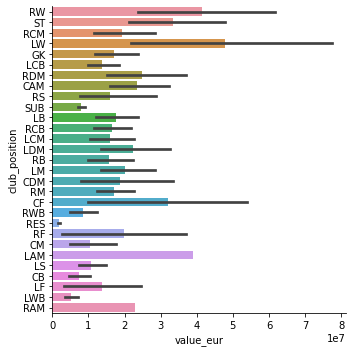

In [244]:
#Total market value of players according to position(before transformation) 
plt.figure(figsize=(10,10),dpi=200)
graph = sns.catplot(y="club_position", x="value_eur", kind="bar",  data=finaldf)
plt.show()

In [245]:
finaldf.club_position = pd.Categorical(finaldf.club_position)

In [246]:
finaldf['club_position']= finaldf['club_position'].replace(['CM', 'RM', 'LM', 'CDM', 'CAM','LDM','RDM','LAM', 'RAM', 'RCM','LCM', 'MIDFIELDERS'], ['MIDFIELDER', 'MIDFIELDER', 'MIDFIELDER','MIDFIELDER','MIDFIELDER', 'MIDFIELDER', 'MIDFIELDER','MIDFIELDER','MIDFIELDER', 'MIDFIELDER','MIDFIELDER', 'MIDFIELDER'])


In [247]:
finaldf['club_position']= finaldf['club_position'].replace(['CB', 'RB', 'LB', 'LWB', 'RWB', 'LCB','RCB'], ['DEFENDER', 'DEFENDER', 'DEFENDER', 'DEFENDER', 'DEFENDER','DEFENDER','DEFENDER'])


In [248]:
finaldf['club_position']= finaldf['club_position'].replace(['ST', 'LS','RS','LF','CF', 'RF','LN','RW', 'LW'], ['ATTACKER', 'ATTACKER','ATTACKER', 'ATTACKER','ATTACKER', 'ATTACKER','ATTACKER', 'ATTACKER','ATTACKER'])

<Figure size 2000x2000 with 0 Axes>

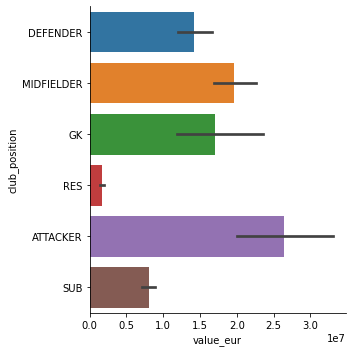

In [249]:
#Total market value of players according to position(after transformation) 
plt.figure(figsize=(10,10),dpi=200)
graph = sns.catplot(y="club_position", x="value_eur", kind="bar",  data=finaldf)
plt.show()

In [250]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,Unique,144300000.0,85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,92,93,93,93,92,"1,072,960",78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0,1
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,Unique,197200000.0,78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,85,88,88,88,85,"264,938",119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0,2
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,Unique,83300000.0,87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,88,89,89,89,88,"1,642,013",45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0,0
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,Unique,373500000.0,97.0,88.0,80.0,92.0,36.0,77.0,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,NaN,90,90,90,90,90,"307,816",194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0,1
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,Unique,232200000.0,76.0,86.0,93.0,88.0,64.0,78.0,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN,88,87,87,87,88,"135,087",125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,69,3,69,3,69,3,75,3,21.0,3.0,0


In [251]:
finaldf['club_position'].value_counts()

SUB           696
RES           446
DEFENDER      241
MIDFIELDER    234
ATTACKER      105
GK             58
Name: club_position, dtype: int64

There are 696 players in the dataset whose club_position are not defined as they are playing as substitite<br>
There are 446 players for whom position is mentioned as RES indicating there are currently kept in Reserve position in the club

In [252]:
finaldf.to_excel(r'/Users/swapnilsrivastava/Desktop/cleandata.xlsx', index = False)

In [253]:
#since shooting, passing, dribbling, defending and physic are the average of the players' sub attributes which are already in the dataset, hence we are removing the six attributes as it is having missing values and hence not the corrrect data
finaldf.drop(['shooting', 'dribbling', 'defending','physic','passing', 'pace'], axis=1, inplace=True)

In [254]:
finaldf.drop(['release_clause_eur'], axis=1, inplace=True)

In [255]:
#combining all the pace values: Pace is the speed with which a player walks or runs: It comprises of two attributes: acceleration and sprint_speed
finaldf['pace_new'] = finaldf[['pace_acceleration', 'pace_sprint_speed']].mean(axis=1)

In [256]:
finaldf['passing_new'] = finaldf[['Passing_crossing', 'passing_short_passing', 'passing_curve', 'passing_fk_accuracy', 'passing_long_passing', 'passing_vision']].mean(axis=1)

In [257]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,Unique,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,92,93,93,93,92,"1,072,960",78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0,1,85.5,91.500000
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,Unique,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,85,88,88,88,85,"264,938",119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0,2,78.0,78.500000
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,Unique,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,88,89,89,89,88,"1,642,013",45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0,0,86.5,80.833333
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,Unique,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,NaN,90,90,90,90,90,"307,816",194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0,1,97.0,77.500000
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,Unique,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN,88,87,87,87,88,"135,087",125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,69,3,69,3,69,3,75,3,21.0,3.0,0,76.0,90.500000


In [258]:
finaldf['shooting_new'] = finaldf[['shooting_positioning','shooting_volleys', 'shooting_finishing','shooting_shot_power', 'shooting_long_shots','shooting_penalties']].mean(axis=1)

In [259]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,Unique,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,92,93,93,93,92,"1,072,960",78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0,1,85.5,91.500000,88.500000
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,Unique,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,85,88,88,88,85,"264,938",119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0,2,78.0,78.500000,91.000000
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,Unique,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,88,89,89,89,88,"1,642,013",45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0,0,86.5,80.833333,91.833333
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,Unique,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,NaN,90,90,90,90,90,"307,816",194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0,1,97.0,77.500000,85.833333
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,Unique,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN,88,87,87,87,88,"135,087",125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,69,3,69,3,69,3,75,3,21.0,3.0,0,76.0,90.500000,86.166667


In [260]:
finaldf['defending_new'] = finaldf[['defending_heading_accuracy', 'defending_interceptions', 'defending_marking_awareness', 'defending_standing_tackle', 'defending_sliding_tackle']].mean(axis=1)

In [ ]:
finaldf.head()

In [261]:
finaldf['dribbling_new'] = finaldf[['dribbling_dribbling', 'dribbling_ball_control', 'dribbling_agility','dribbling_composure', 'dribbling_balance', 'dribbling_reactions']].mean(axis=1)

In [262]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,Unique,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,92,93,93,93,92,"1,072,960",78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,Unique,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,85,88,88,88,85,"264,938",119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,Unique,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,88,89,89,89,88,"1,642,013",45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,Unique,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,NaN,90,90,90,90,90,"307,816",194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,Unique,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN,88,87,87,87,88,"135,087",125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,69,3,69,3,69,3,75,3,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000


In [263]:
finaldf['physical_new']=finaldf[['physical_jumping', 'physical_strength', 'physical_stamina','physical_aggression']].mean(axis=1)

In [264]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,Passing_crossing,shooting_finishing,defending_heading_accuracy,passing_short_passing,shooting_volleys,dribbling_dribbling,passing_curve,passing_fk_accuracy,passing_long_passing,dribbling_ball_control,pace_acceleration,pace_sprint_speed,dribbling_agility,dribbling_reactions,dribbling_balance,shooting_shot_power,physical_jumping,physical_stamina,physical_strength,shooting_long_shots,physical_aggression,defending_interceptions,shooting_positioning,passing_vision,shooting_penalties,dribbling_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,Unique,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,92,93,93,93,92,"1,072,960",78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,Unique,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,85,88,88,88,85,"264,938",119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,Unique,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,88,89,89,89,88,"1,642,013",45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,Unique,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,NaN,90,90,90,90,90,"307,816",194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,Unique,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN,88,87,87,87,88,"135,087",125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,69,3,69,3,69,3,75,3,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50


In [265]:
finaldf['goalkeeping_new']=finaldf[['goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes', 'goalkeeping_speed']].mean(axis=1)

In [266]:
finaldf.drop(['pace_acceleration', 'pace_sprint_speed', 'Passing_crossing', 'passing_short_passing', 'passing_curve', 'passing_fk_accuracy', 'passing_long_passing', 'passing_vision', 'physical_jumping', 'physical_strength', 'physical_stamina','physical_aggression', 'dribbling_dribbling', 'dribbling_ball_control', 'dribbling_agility','dribbling_composure', 'dribbling_balance', 'dribbling_reactions', 'defending_heading_accuracy', 'defending_interceptions', 'defending_marking_awareness', 'defending_standing_tackle', 'defending_sliding_tackle', 'shooting_positioning','shooting_volleys', 'shooting_finishing','shooting_shot_power', 'shooting_long_shots', 'shooting_penalties', 'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes', 'goalkeeping_speed'], axis=1, inplace=True)

In [267]:
finaldf.shape

(1780, 79)

In [268]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,Unique,92,93,93,93,92,"1,072,960",78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,Unique,85,88,88,88,85,"264,938",119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,Unique,88,89,89,89,88,"1,642,013",45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,Unique,90,90,90,90,90,"307,816",194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,Unique,88,87,87,87,88,"135,087",125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,69,3,69,3,69,3,75,3,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2


In [269]:
#Removing comma from Wikipedia_Views column so as to convert it into integer 

finaldf['Wikipedia_Views']=finaldf['Wikipedia_Views'].str.replace(',','')


In [270]:
finaldf.shape

(1780, 79)

In [271]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,Unique,92,93,93,93,92,1072960,78000000.0,Medium,Low,89,3,89,3,89,3,93,1,93,1,93,-1,91,2,87,3,87,3,87,3,91,2,66,3,64,3,64,3,64,3,66,3,61,3,50,3,50,3,50,3,61,3,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,Unique,85,88,88,88,85,264938,119500000.0,High,Medium,90,2,90,2,90,2,86,3,86,3,86,3,84,3,80,3,80,3,80,3,84,3,64,3,66,3,66,3,66,3,64,3,61,3,60,3,60,3,60,3,61,3,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,Unique,88,89,89,89,88,1642013,45000000.0,High,Low,90,1,90,1,90,1,86,3,86,3,86,3,86,3,78,3,78,3,78,3,86,3,63,3,59,3,59,3,59,3,63,3,60,3,53,3,53,3,53,3,60,3,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,Unique,90,90,90,90,90,307816,194000000.0,High,Low,83,3,83,3,83,3,89,2,89,2,89,2,89,2,82,3,82,3,82,3,89,2,67,3,63,3,63,3,63,3,67,3,62,3,50,3,50,3,50,3,62,3,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,Unique,88,87,87,87,88,135087,125500000.0,High,High,83,3,83,3,83,3,89,2,89,2,89,2,89,2,89,2,89,2,89,2,89,2,79,3,80,3,80,3,80,3,79,3,75,3,69,3,69,3,69,3,75,3,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2


In [272]:
pd.set_option('display.max_rows', 120)

Converting the datatypes of required variables 

In [273]:
print(finaldf.dtypes)

sofifa_id                       int64
long_name                      object
overall                         int64
potential                       int64
value_eur                       int64
wage_eur                        int64
age                             int64
height_cm                       int64
weight_kg                       int64
club_team_id                    int64
club_position                category
club_contract_valid_until       int64
nationality_id                  int64
preferred_foot                 object
weak_foot                       int64
skill_moves                     int64
international_reputation        int64
body_type                      object
lw                             object
lf                             object
cf                             object
rf                             object
rw                             object
Wikipedia_Views                object
wage_avg                      float64
work_rate1                     object
work_rate2  

In [274]:
cols = ['ls1', 'st1', 'rs1', 'lam1', 'cam1', 'ram1', 'lm1', 'lcm1', 'cm1', 'rcm1', 'rm1', 'lwb1', 'ldm1', 'cdm1', 'rdm1', 'rwb1', 'lb1', 'lcb1', 'cb1', 'rcb1', 'rb1', 'ls2', 'st2', 'rs2', 'lam2', 'cam2', 'ram2', 'lm2', 'lcm2', 'cm2', 'rcm2', 'rm2', 'lwb2', 'ldm2', 'cdm2', 'rdm2', 'rwb2', 'lb2', 'lcb2', 'cb2', 'rcb2', 'rb2']
finaldf[cols] = finaldf[cols].apply(pd.to_numeric, errors='coerce', axis=1)

In [275]:
cols=['lw', 'lf', 'cf', 'rf', 'rw', 'Wikipedia_Views']
finaldf[cols]= finaldf[cols].apply(pd.to_numeric, errors='coerce', axis=1)

In [276]:
print(finaldf.dtypes)

sofifa_id                       int64
long_name                      object
overall                         int64
potential                       int64
value_eur                       int64
wage_eur                        int64
age                             int64
height_cm                       int64
weight_kg                       int64
club_team_id                    int64
club_position                category
club_contract_valid_until       int64
nationality_id                  int64
preferred_foot                 object
weak_foot                       int64
skill_moves                     int64
international_reputation        int64
body_type                      object
lw                            float64
lf                            float64
cf                            float64
rf                            float64
rw                            float64
Wikipedia_Views               float64
wage_avg                      float64
work_rate1                     object
work_rate2  

In [277]:
#counting null values in all categorical columns
cat_columns = finaldf.select_dtypes('object', 'category').columns
null_counts(finaldf[cat_columns])

long_name : 0
preferred_foot : 0
body_type : 0
work_rate1 : 0
work_rate2 : 0


In [278]:
#checking the values are correct or not for categorical columns
finaldf['body_type'].value_counts()

Normal (170-185)    473
Normal (185+)       439
Lean (170-185)      405
Lean (185+)         227
Unique               79
Stocky (170-185)     49
Stocky (185+)        43
Normal (170-)        36
Lean (170-)          25
Stocky (170-)         4
Name: body_type, dtype: int64

In [279]:
#splitting the data in the column with body_type in one and weight range in another and then removing the weight range column 
#so as to keep the four main body_type category Normal, Lean, Unique, Stocky
finaldf[['body_type1','body_weight']] = finaldf['body_type'].str.split(' ', expand=True)


In [280]:
finaldf.head()


,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new,body_type1,body_weight
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,Unique,92.0,93.0,93.0,93.0,92.0,1072960.0,78000000.0,Medium,Low,89.0,3.0,89.0,3.0,89.0,3.0,93.0,1.0,93.0,1.0,93.0,-1.0,91.0,2.0,87.0,3.0,87.0,3.0,87.0,3.0,91.0,2.0,66.0,3.0,64.0,3.0,64.0,3.0,64.0,3.0,66.0,3.0,61.0,3.0,50.0,3.0,50.0,3.0,50.0,3.0,61.0,3.0,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8,Unique,None
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,Unique,85.0,88.0,88.0,88.0,85.0,264938.0,119500000.0,High,Medium,90.0,2.0,90.0,2.0,90.0,2.0,86.0,3.0,86.0,3.0,86.0,3.0,84.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,84.0,3.0,64.0,3.0,66.0,3.0,66.0,3.0,66.0,3.0,64.0,3.0,61.0,3.0,60.0,3.0,60.0,3.0,60.0,3.0,61.0,3.0,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2,Unique,None
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,Unique,88.0,89.0,89.0,89.0,88.0,1642013.0,45000000.0,High,Low,90.0,1.0,90.0,1.0,90.0,1.0,86.0,3.0,86.0,3.0,86.0,3.0,86.0,3.0,78.0,3.0,78.0,3.0,78.0,3.0,86.0,3.0,63.0,3.0,59.0,3.0,59.0,3.0,59.0,3.0,63.0,3.0,60.0,3.0,53.0,3.0,53.0,3.0,53.0,3.0,60.0,3.0,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6,Unique,None
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,Unique,90.0,90.0,90.0,90.0,90.0,307816.0,194000000.0,High,Low,83.0,3.0,83.0,3.0,83.0,3.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,82.0,3.0,82.0,3.0,82.0,3.0,89.0,2.0,67.0,3.0,63.0,3.0,63.0,3.0,63.0,3.0,67.0,3.0,62.0,3.0,50.0,3.0,50.0,3.0,50.0,3.0,62.0,3.0,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4,Unique,None
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,Unique,88.0,87.0,87.0,87.0,88.0,135087.0,125500000.0,High,High,83.0,3.0,83.0,3.0,83.0,3.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,79.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,79.0,3.0,75.0,3.0,69.0,3.0,69.0,3.0,69.0,3.0,75.0,3.0,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2,Unique,None


In [281]:
finaldf.drop(['body_weight'], axis=1, inplace=True)


In [282]:
finaldf.head()

,sofifa_id,long_name,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,body_type,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new,body_type1
0,158023,Lionel Andrés Messi Cuccittini,93,93,78000000,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,Unique,92.0,93.0,93.0,93.0,92.0,1072960.0,78000000.0,Medium,Low,89.0,3.0,89.0,3.0,89.0,3.0,93.0,1.0,93.0,1.0,93.0,-1.0,91.0,2.0,87.0,3.0,87.0,3.0,87.0,3.0,91.0,2.0,66.0,3.0,64.0,3.0,64.0,3.0,64.0,3.0,66.0,3.0,61.0,3.0,50.0,3.0,50.0,3.0,50.0,3.0,61.0,3.0,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8,Unique
1,188545,Robert Lewandowski,92,92,119500000,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,Unique,85.0,88.0,88.0,88.0,85.0,264938.0,119500000.0,High,Medium,90.0,2.0,90.0,2.0,90.0,2.0,86.0,3.0,86.0,3.0,86.0,3.0,84.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,84.0,3.0,64.0,3.0,66.0,3.0,66.0,3.0,66.0,3.0,64.0,3.0,61.0,3.0,60.0,3.0,60.0,3.0,60.0,3.0,61.0,3.0,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2,Unique
2,20801,Cristiano Ronaldo dos Santos Aveiro,91,91,45000000,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,Unique,88.0,89.0,89.0,89.0,88.0,1642013.0,45000000.0,High,Low,90.0,1.0,90.0,1.0,90.0,1.0,86.0,3.0,86.0,3.0,86.0,3.0,86.0,3.0,78.0,3.0,78.0,3.0,78.0,3.0,86.0,3.0,63.0,3.0,59.0,3.0,59.0,3.0,59.0,3.0,63.0,3.0,60.0,3.0,53.0,3.0,53.0,3.0,53.0,3.0,60.0,3.0,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6,Unique
3,231747,Kylian Mbappé Lottin,91,95,194000000,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,Unique,90.0,90.0,90.0,90.0,90.0,307816.0,194000000.0,High,Low,83.0,3.0,83.0,3.0,83.0,3.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,82.0,3.0,82.0,3.0,82.0,3.0,89.0,2.0,67.0,3.0,63.0,3.0,63.0,3.0,63.0,3.0,67.0,3.0,62.0,3.0,50.0,3.0,50.0,3.0,50.0,3.0,62.0,3.0,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4,Unique
4,192985,Kevin De Bruyne,91,91,125500000,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,Unique,88.0,87.0,87.0,87.0,88.0,135087.0,125500000.0,High,High,83.0,3.0,83.0,3.0,83.0,3.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,79.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,79.0,3.0,75.0,3.0,69.0,3.0,69.0,3.0,69.0,3.0,75.0,3.0,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2,Unique


In [283]:
#checking  again the values are correct or not for categorical columns body_type
finaldf['body_type1'].value_counts()

Normal    948
Lean      657
Stocky     96
Unique     79
Name: body_type1, dtype: int64

In [284]:
#run similar checks to remove bad data for other categorical variables
categoricals = finaldf.select_dtypes('object')
for col in categoricals.columns:
    print(col)
    print("----------------------------")
    print(finaldf[col].value_counts())

long_name
----------------------------
Lionel Andrés Messi Cuccittini    1
Alexandre Letellier               1
Rob Elliot                        1
Kjell Scherpen                    1
Elbasan Rashani                   1
                                 ..
Birger Solberg Meling             1
Kristoffer Vassbakk Ajer          1
Mohamed Amine Elyounoussi         1
Joshua Christian Kojo King        1
Oliver Webber                     1
Name: long_name, Length: 1780, dtype: int64
preferred_foot
----------------------------
Right    1335
Left      445
Name: preferred_foot, dtype: int64
body_type
----------------------------
Normal (170-185)    473
Normal (185+)       439
Lean (170-185)      405
Lean (185+)         227
Unique               79
Stocky (170-185)     49
Stocky (185+)        43
Normal (170-)        36
Lean (170-)          25
Stocky (170-)         4
Name: body_type, dtype: int64
work_rate1
----------------------------
Medium    1105
High       580
Low         95
Name: work_rate1, dt

In [285]:
finaldf.drop(['body_type', 'long_name'], axis=1, inplace=True)


In [286]:
categoricals = finaldf.select_dtypes('object')
for col in categoricals.columns:
    print(col)
    print("----------------------------")
    print(finaldf[col].value_counts())

preferred_foot
----------------------------
Right    1335
Left      445
Name: preferred_foot, dtype: int64
work_rate1
----------------------------
Medium    1105
High       580
Low         95
Name: work_rate1, dtype: int64
work_rate2
----------------------------
Medium    1265
High       400
Low        115
Name: work_rate2, dtype: int64
body_type1
----------------------------
Normal    948
Lean      657
Stocky     96
Unique     79
Name: body_type1, dtype: int64


## Exploratory Data Analysis

In [256]:
#EDA-------------
import matplotlib.pyplot as plt
from collections import Counter
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")
import seaborn as sns
from matplotlib import rcParams

In [257]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

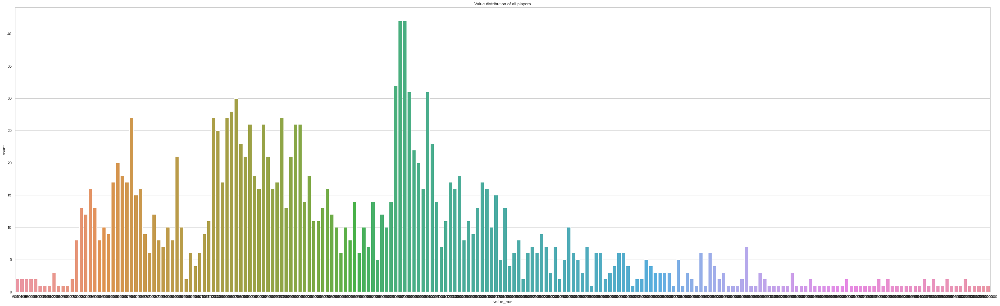

In [490]:
# Value ditribution
plt.figure(1, figsize=(50, 15))
sns.set(style="whitegrid")
sns.countplot( x= 'value_eur', data=finaldf)
plt.title('Value distribution of all players')
plt.show()


/Users/swapnilsrivastava/Documents/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, '   Market value distribution before sqrt transformation')

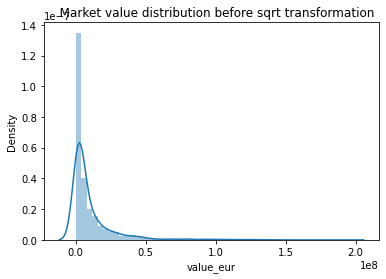

In [287]:
sns.distplot(finaldf['value_eur'])
plt.title('   Market value distribution before sqrt transformation')


The above graph is showing that the target variable is highly skewed
Hence a sqrt transformation is applied on it <br>
A square root transformation can be useful for: Normalizing a skewed distribution

In [288]:
finaldf['value_eur']=np.sqrt((finaldf['value_eur']))

/Users/swapnilsrivastava/Documents/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Market Value distribution after sqrt transformation')

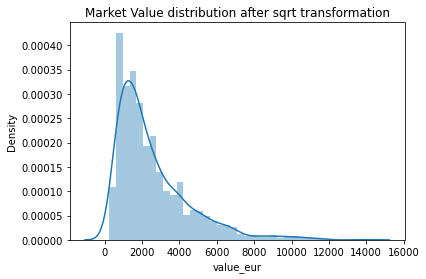

In [289]:
sns.distplot(finaldf['value_eur'])
plt.title('Market Value distribution after sqrt transformation')

In [497]:
finaldf.columns

Index(['sofifa_id', 'overall', 'potential', 'value_eur', 'wage_eur', 'age',
       'height_cm', 'weight_kg', 'club_team_id', 'club_position',
       'club_contract_valid_until', 'nationality_id', 'preferred_foot',
       'weak_foot', 'skill_moves', 'international_reputation', 'lw', 'lf',
       'cf', 'rf', 'rw', 'Wikipedia_Views', 'work_rate1', 'work_rate2', 'ls1',
       'ls2', 'st1', 'st2', 'rs1', 'rs2', 'lam1', 'lam2', 'cam1', 'cam2',
       'ram1', 'ram2', 'lm1', 'lm2', 'lcm1', 'lcm2', 'cm1', 'cm2', 'rcm1',
       'rcm2', 'rm1', 'rm2', 'lwb1', 'lwb2', 'ldm1', 'ldm2', 'cdm1', 'cdm2',
       'rdm1', 'rdm2', 'rwb1', 'rwb2', 'lb1', 'lb2', 'lcb1', 'lcb2', 'cb1',
       'cb2', 'rcb1', 'rcb2', 'rb1', 'rb2', 'gk1', 'gk2', 'League_name_code',
       'pace_new', 'passing_new', 'shooting_new', 'defending_new',
       'dribbling_new', 'physical_new', 'goalkeeping_new', 'body_type1'],
      dtype='object')

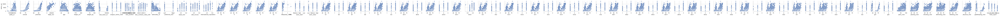

In [501]:
sns.pairplot(finaldf, x_vars=['sofifa_id', 'overall', 'potential', 'wage_eur', 'age',
       'height_cm', 'weight_kg', 'club_team_id','League_name_code',
       'club_position', 'club_contract_valid_until', 'nationality_id',
       'preferred_foot', 'weak_foot', 'skill_moves',
       'international_reputation', 'lw', 'lf', 'cf', 'rf', 'rw',
       'Wikipedia_Views', 'work_rate1', 'work_rate2', 'ls1', 'ls2', 'st1',
       'st2', 'rs1', 'rs2', 'lam1', 'lam2', 'cam1', 'cam2', 'ram1', 'ram2',
       'lm1', 'lm2', 'lcm1', 'lcm2', 'cm1', 'cm2', 'rcm1', 'rcm2', 'rm1',
       'rm2', 'lwb1', 'lwb2', 'ldm1', 'ldm2', 'cdm1', 'cdm2', 'rdm1', 'rdm2',
       'rwb1', 'rwb2', 'lb1', 'lb2', 'lcb1', 'lcb2', 'cb1', 'cb2', 'rcb1',
       'rcb2', 'rb1', 'rb2', 'gk1', 'gk2', 'pace_new', 'passing_new', 'shooting_new',
       'defending_new', 'dribbling_new', 'physical_new', 'goalkeeping_new', 'body_type1'], y_vars='value_eur', size=2, aspect=0.8)

In [ ]:
plt.figure(1, figsize=(18, 7))
sns.set(style="whitegrid")
g=sns.pairplot(finaldf, height=1.2, aspect=1.5)
plt.yticks(rotation=90); 
plt.show()

<Figure size 1296x504 with 0 Axes>

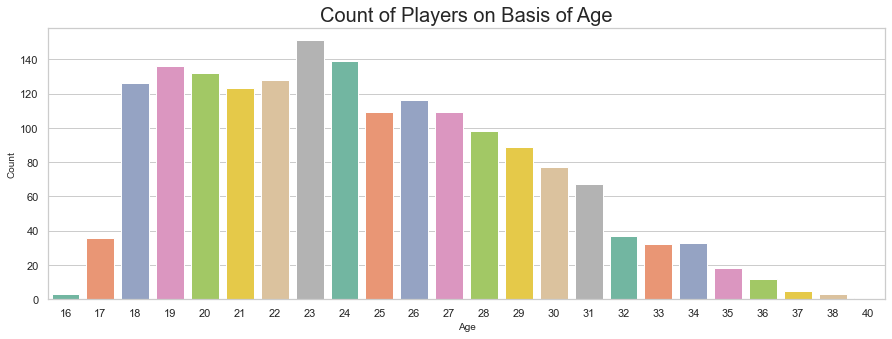

In [507]:
#1. Count of players on the basis of age
plt.figure(figsize= (15,5))

ax = sns.countplot(x='age', data=finaldf, palette='Set2')
ax.set_title(label='Count of Players on Basis of Age', fontsize=20)

ax.set_xlabel(xlabel='Age', fontsize=10)
ax.set_ylabel(ylabel='Count', fontsize=10)

plt.show()

In [262]:
dfage = finaldf["age"].mean()
print(dfage)

24.44887640449438


###### The age of maximum players lie between 18 to 27 years with a mean of around 24 years<br>
#The minimum age of the players in the game is 16 years whereas the maximum age is 40 year

In [490]:
import json
from IPython.core.display import display, HTML
import tempfile

/var/folders/_y/xn3ctgpx2kq_z25wf8cn757r0000gn/T/ipykernel_1625/1204432537.py:2: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [491]:
import plotly.graph_objects as go
import plotly.express as px

In [492]:
finaldf_EDA = pd.read_excel('/Users/swapnilsrivastava/Desktop/Disseration data/datasets/FinalDataset.xlsx')

In [495]:
country_count = finaldf_EDA.nationality_name.value_counts()
counts = country_count.sort_index().reset_index().nationality_name

In [496]:
world_geojson = json.load(open("/Users/swapnilsrivastava/Desktop/Disseration data/countries.geo.json", "r"))
countries = pd.DataFrame(finaldf_EDA.groupby(['nationality_name']).overall.mean())
countries["value_eur"] = finaldf_EDA.groupby(['nationality_name']).value_eur.mean()
countries.reset_index(inplace = True)
countries["count"] = counts

In [497]:
fig = px.scatter_geo(
    countries,
    geojson=world_geojson,
    featureidkey='properties.name', 
    locations='nationality_name',
    size = 'count',
    color='value_eur',
    color_continuous_scale='Reds'
)

fig.update_layout(
    title_text = 'Number of players per country',
    geo = dict(
        showland = True,
        landcolor = 'rgb(122, 122, 122)',
        countrycolor = 'rgb(204, 204, 00)',
    ),
)

fig.show()

In the above graph:- 
-The size of circle denotes the count of player from that country
-The colour denotes the average of the player's value of the players belonging to that particular country

While going through the graph, I saw that the English player's data was not visible on the map. I found that because names in the csv and the JSON were not matching, so I created a new similar finaldfCopy by copying the finaldf changed the name values in DataFrame to be consistent with the ones in the JSON file and then again plotted it on the map.
** I changed the nationality of all the players' with 'England', 'Wales', 'Northern Ireland', 'Scotland' to 'United Kingdom'

In [515]:
finaldf_EDA['nationality_name'] = finaldf_EDA['nationality_name'].replace(['England', 'Wales', 'Northern Ireland', 'Scotland'], 'United Kingdom')

In [516]:
country_count = finaldf_EDA.nationality_name.value_counts()
counts = country_count.sort_index().reset_index().nationality_name

In [272]:
countries.head(100)

,nationality_name,overall,value_eur,count
0,Albania,70.000000,3.800000e+06,1
1,Algeria,74.375000,1.168125e+07,16
2,Angola,66.500000,1.775000e+06,2
3,Argentina,78.388889,2.377639e+07,18
4,Armenia,63.000000,2.175000e+06,2
5,Australia,63.666667,1.200000e+06,3
6,Austria,74.000000,9.501000e+06,30
7,Belgium,74.794118,1.771103e+07,34
8,Benin,73.000000,3.666667e+06,3
9,Bosnia and Herzegovina,73.800000,4.020000e+06,5


In [518]:
finaldf_EDA['nationality_name'].value_counts()

France                    360
United Kingdom            318
Germany                   275
Brazil                     54
Netherlands                53
Spain                      53
Portugal                   40
Belgium                    34
Senegal                    31
Austria                    30
Switzerland                28
Denmark                    28
Republic of Ireland        26
Côte d'Ivoire              22
Mali                       20
Poland                     19
Ghana                      18
Nigeria                    18
Argentina                  18
Norway                     17
United States              16
Algeria                    16
Morocco                    15
Croatia                    13
Japan                      12
Turkey                     12
Cameroon                   12
Czech Republic             11
Greece                     11
Sweden                     10
Italy                      10
Serbia                     10
Congo DR                    8
Colombia  

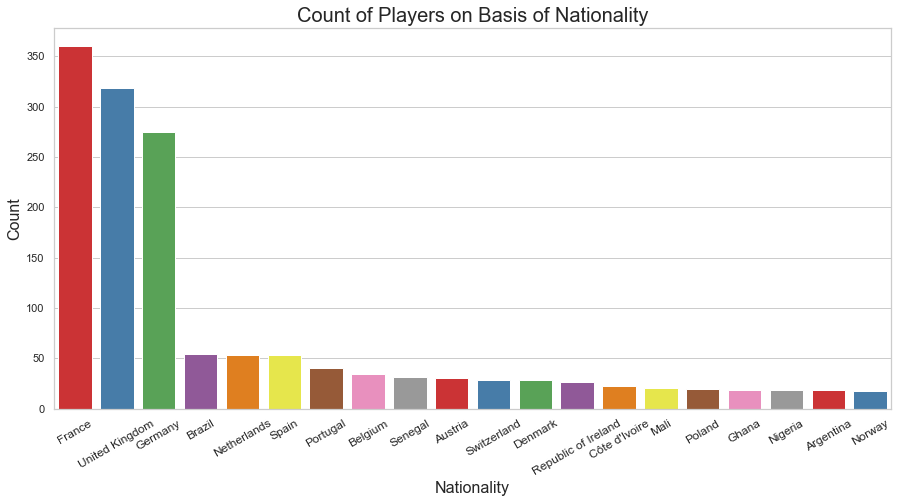

In [519]:
#2. Count of players on the basis of nationality
plt.figure(figsize= (15, 7))

ax = sns.countplot(x='nationality_name', data=finaldf_EDA, palette='Set1', order=finaldf_EDA.nationality_name.value_counts().iloc[:20].index)
ax.set_title(label='Count of Players on Basis of Nationality', fontsize=20)

ax.set_xlabel(xlabel='Nationality', fontsize=16)
ax.set_ylabel(ylabel='Count', fontsize=16)
plt.xticks(rotation=30, fontsize=12)

plt.show()

###### 3.  GeoScatter to visualize the mean overall, average player's value and total number of players from each country.
GeoJSON is a special type of file which is made to represent simple geographical features, along with their non-spatial attributes. Here the features' polygonal coordinates relate with their actual coordinates on the globe, making it easier to plot entities likes districts and states if their coordinates are not provided already in the module.
I made a chloropleth and GeoScatter to visualize the mean overall, average player's value and total number of players from each country.



In [520]:
world_geojson = json.load(open("/Users/swapnilsrivastava/Desktop/Disseration data/countries.geo.json", "r"))
countries = pd.DataFrame(finaldf_EDA.groupby(['nationality_name']).overall.mean())
countries["value_eur"] = finaldf_EDA.groupby(['nationality_name']).value_eur.mean()
countries.reset_index(inplace = True)
countries["count"] = counts

In [521]:
countries.head(100)

,nationality_name,overall,value_eur,count
0,Albania,70.000000,3.800000e+06,1
1,Algeria,74.375000,1.168125e+07,16
2,Angola,66.500000,1.775000e+06,2
3,Argentina,78.388889,2.377639e+07,18
4,Armenia,63.000000,2.175000e+06,2
5,Australia,63.666667,1.200000e+06,3
6,Austria,74.000000,9.501000e+06,30
7,Belgium,74.794118,1.771103e+07,34
8,Benin,73.000000,3.666667e+06,3
9,Bosnia and Herzegovina,73.800000,4.020000e+06,5


In [498]:
finaldf.shape

(1780, 58)

In [522]:
print(countries.dtypes)

nationality_name     object
overall             float64
value_eur           float64
count                 int64
dtype: object


In [1467]:
fig = px.scatter_geo(
    countries,
    geojson=world_geojson,
    featureidkey='properties.name', 
    locations='nationality_name',
    size = 'count',
    color='value_eur',
    color_continuous_scale='Reds'
)


fig.update_layout(
    title_text = 'Number of players per country',
    geo = dict(
        showland = True,
        landcolor = 'rgb(122, 122, 122)',
        countrycolor = 'rgb(204, 204, 00)',
    ),
)

fig.show()

In [1468]:
fig = px.choropleth(
    countries,
    geojson=world_geojson,
    featureidkey='properties.name', 
    locations='nationality_name',
    color='overall',
    color_continuous_scale='Reds'
)

fig.update_layout(
    title_text = 'Average overall rating per nationality',
    geo = dict(
        showland = True,
        countrycolor = 'rgb(204, 204, 00)',
        
    ),
)

fig.show()

The above graph denotes
-The brightness of the colour denotes the mean of the overall rating of all the players belonging to that nationality

In [525]:
finaldf.head()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,lw,lf,cf,rf,rw,Wikipedia_Views,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new,body_type1
0,158023,93,93,8831.760866,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,92.0,93.0,93.0,93.0,92.0,1072960.0,Medium,Low,89.0,3.0,89.0,3.0,89.0,3.0,93.0,1.0,93.0,1.0,93.0,-1.0,91.0,2.0,87.0,3.0,87.0,3.0,87.0,3.0,91.0,2.0,66.0,3.0,64.0,3.0,64.0,3.0,64.0,3.0,66.0,3.0,61.0,3.0,50.0,3.0,50.0,3.0,50.0,3.0,61.0,3.0,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8,Unique
1,188545,92,92,10931.605555,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,85.0,88.0,88.0,88.0,85.0,264938.0,High,Medium,90.0,2.0,90.0,2.0,90.0,2.0,86.0,3.0,86.0,3.0,86.0,3.0,84.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,84.0,3.0,64.0,3.0,66.0,3.0,66.0,3.0,66.0,3.0,64.0,3.0,61.0,3.0,60.0,3.0,60.0,3.0,60.0,3.0,61.0,3.0,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2,Unique
2,20801,91,91,6708.203932,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,88.0,89.0,89.0,89.0,88.0,1642013.0,High,Low,90.0,1.0,90.0,1.0,90.0,1.0,86.0,3.0,86.0,3.0,86.0,3.0,86.0,3.0,78.0,3.0,78.0,3.0,78.0,3.0,86.0,3.0,63.0,3.0,59.0,3.0,59.0,3.0,59.0,3.0,63.0,3.0,60.0,3.0,53.0,3.0,53.0,3.0,53.0,3.0,60.0,3.0,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6,Unique
3,231747,91,95,13928.388277,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,90.0,90.0,90.0,90.0,90.0,307816.0,High,Low,83.0,3.0,83.0,3.0,83.0,3.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,82.0,3.0,82.0,3.0,82.0,3.0,89.0,2.0,67.0,3.0,63.0,3.0,63.0,3.0,63.0,3.0,67.0,3.0,62.0,3.0,50.0,3.0,50.0,3.0,50.0,3.0,62.0,3.0,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4,Unique
4,192985,91,91,11202.678251,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,88.0,87.0,87.0,87.0,88.0,135087.0,High,High,83.0,3.0,83.0,3.0,83.0,3.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,79.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,79.0,3.0,75.0,3.0,69.0,3.0,69.0,3.0,69.0,3.0,75.0,3.0,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2,Unique


In [528]:
finaldf["value_eur"] = round(finaldf["value_eur"].astype(float),2)

In [529]:
finaldf.head()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,lw,lf,cf,rf,rw,Wikipedia_Views,work_rate1,work_rate2,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new,body_type1
0,158023,93,93,8831.76,8831.76,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,92.0,93.0,93.0,93.0,92.0,1072960.0,Medium,Low,89.0,3.0,89.0,3.0,89.0,3.0,93.0,1.0,93.0,1.0,93.0,-1.0,91.0,2.0,87.0,3.0,87.0,3.0,87.0,3.0,91.0,2.0,66.0,3.0,64.0,3.0,64.0,3.0,64.0,3.0,66.0,3.0,61.0,3.0,50.0,3.0,50.0,3.0,50.0,3.0,61.0,3.0,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8,Unique
1,188545,92,92,10931.61,10931.61,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,85.0,88.0,88.0,88.0,85.0,264938.0,High,Medium,90.0,2.0,90.0,2.0,90.0,2.0,86.0,3.0,86.0,3.0,86.0,3.0,84.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,84.0,3.0,64.0,3.0,66.0,3.0,66.0,3.0,66.0,3.0,64.0,3.0,61.0,3.0,60.0,3.0,60.0,3.0,60.0,3.0,61.0,3.0,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2,Unique
2,20801,91,91,6708.20,6708.20,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,88.0,89.0,89.0,89.0,88.0,1642013.0,High,Low,90.0,1.0,90.0,1.0,90.0,1.0,86.0,3.0,86.0,3.0,86.0,3.0,86.0,3.0,78.0,3.0,78.0,3.0,78.0,3.0,86.0,3.0,63.0,3.0,59.0,3.0,59.0,3.0,59.0,3.0,63.0,3.0,60.0,3.0,53.0,3.0,53.0,3.0,53.0,3.0,60.0,3.0,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6,Unique
3,231747,91,95,13928.39,13928.39,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,90.0,90.0,90.0,90.0,90.0,307816.0,High,Low,83.0,3.0,83.0,3.0,83.0,3.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,82.0,3.0,82.0,3.0,82.0,3.0,89.0,2.0,67.0,3.0,63.0,3.0,63.0,3.0,63.0,3.0,67.0,3.0,62.0,3.0,50.0,3.0,50.0,3.0,50.0,3.0,62.0,3.0,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4,Unique
4,192985,91,91,11202.68,11202.68,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,88.0,87.0,87.0,87.0,88.0,135087.0,High,High,83.0,3.0,83.0,3.0,83.0,3.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,79.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,79.0,3.0,75.0,3.0,69.0,3.0,69.0,3.0,69.0,3.0,75.0,3.0,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2,Unique


<Figure size 2000x2000 with 0 Axes>

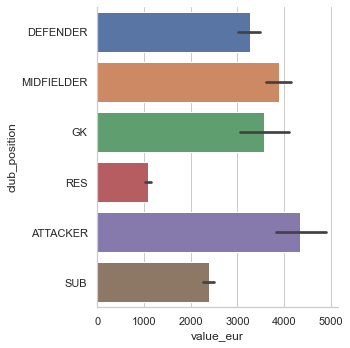

In [530]:
#Total value of players according to position
plt.figure(figsize=(10,10),dpi=200)
graph = sns.catplot(y="club_position", x="value_eur", kind="bar",  data=finaldf)
plt.show()

In [531]:
corr_matrix = finaldf.corr()
corr_matrix

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_contract_valid_until,nationality_id,weak_foot,skill_moves,international_reputation,lw,lf,cf,rf,rw,Wikipedia_Views,ls1,ls2,st1,st2,rs1,rs2,lam1,lam2,cam1,cam2,ram1,ram2,lm1,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,rm1,rm2,lwb1,lwb2,ldm1,ldm2,cdm1,cdm2,rdm1,rdm2,rwb1,rwb2,lb1,lb2,lcb1,lcb2,cb1,cb2,rcb1,rcb2,rb1,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new
sofifa_id,1.000000,-0.572268,0.046701,-0.249921,-0.249921,-0.907600,-0.103167,-0.272148,0.027139,0.189929,0.026596,-0.091162,-0.066227,-0.501433,-0.081588,-0.108175,-0.108175,-0.108175,-0.081588,-0.256636,-0.281127,-0.114645,-0.281127,-0.114645,-0.281127,-0.114645,-0.284016,-0.072824,-0.284016,-0.072824,-0.284016,-0.062170,-0.278605,-0.097376,-0.321340,-0.114489,-0.321340,-0.114489,-0.321340,-0.114489,-0.278605,-0.097376,-0.285108,-0.130498,-0.300037,-0.107862,-0.300037,-0.107862,-0.300037,-0.107862,-0.285108,-0.130498,-0.270018,-0.192160,-0.249603,-0.134834,-0.249603,-0.134834,-0.249603,-0.134834,-0.270018,-0.192160,-0.034063,-0.130132,0.088469,0.148494,-0.177258,-0.140656,-0.099113,-0.147631,-0.274123,-0.214913
overall,-0.572268,1.000000,0.631128,0.830950,0.830950,0.582069,0.028857,0.184165,-0.002452,0.190769,0.047850,0.227493,0.373467,0.666935,0.456978,0.484084,0.484084,0.484084,0.456978,0.297288,0.482138,0.337338,0.482138,0.337338,0.482138,0.337338,0.490451,0.254979,0.490451,0.254979,0.490451,0.239299,0.482129,0.259643,0.549201,0.304332,0.549201,0.304332,0.549201,0.304332,0.482129,0.259643,0.465171,0.372410,0.486272,0.301464,0.486272,0.301464,0.486272,0.301464,0.465171,0.372410,0.440032,0.444768,0.393156,0.327204,0.393156,0.327204,0.393156,0.327204,0.440032,0.444768,0.066140,0.333076,-0.065793,0.253975,0.496440,0.407297,0.312388,0.535538,0.553467,0.010076
potential,0.046701,0.631128,1.000000,0.774346,0.774346,-0.141638,-0.035692,-0.027135,0.023206,0.401207,-0.025751,0.221879,0.340496,0.463352,0.395701,0.404163,0.404163,0.404163,0.395701,0.301716,0.286171,0.341002,0.286171,0.341002,0.286171,0.341002,0.291148,0.282786,0.291148,0.282786,0.291148,0.266019,0.284165,0.281277,0.321136,0.322014,0.321136,0.322014,0.321136,0.322014,0.284165,0.281277,0.240122,0.401281,0.252778,0.341891,0.252778,0.341891,0.252778,0.341891,0.240122,0.401281,0.221597,0.434747,0.190191,0.341817,0.190191,0.341817,0.190191,0.341817,0.221597,0.434747,0.080787,0.340456,-0.149146,0.362544,0.368857,0.301766,0.200884,0.444225,0.306357,-0.100096
value_eur,-0.249921,0.830950,0.774346,1.000000,1.000000,0.210147,-0.027097,0.063491,0.006150,0.290888,0.008436,0.228129,0.412342,0.703479,0.472081,0.490941,0.490941,0.490941,0.472081,0.375637,0.386464,0.473217,0.386464,0.473217,0.386464,0.473217,0.393505,0.380175,0.393505,0.380175,0.393505,0.359944,0.384763,0.382261,0.437862,0.439351,0.437862,0.439351,0.437862,0.439351,0.384763,0.382261,0.344327,0.537327,0.360192,0.464124,0.360192,0.464124,0.360192,0.464124,0.344327,0.537327,0.321385,0.604076,0.279749,0.465890,0.279749,0.465890,0.279749,0.465890,0.321385,0.604076,0.086896,0.479653,-0.134741,0.329948,0.488830,0.417039,0.250039,0.524564,0.434481,-0.075147
wage_eur,-0.249921,0.830950,0.774346,1.000000,1.000000,0.210147,-0.027097,0.063491,0.006150,0.290888,0.008436,0.228129,0.412342,0.703479,0.472081,0.490941,0.490941,0.490941,0.472081,0.375637,0.386464,0.473217,0.386464,0.473217,0.386464,0.473217,0.393505,0.380175,0.393505,0.380175,0.393505,0.359944,0.384763,0.382261,0.437862,0.439351,0.437862,0.439351,0.437862,0.439351,0.384763,0.382261,0.344327,0.537327,0.360192,0.464124,0.360192,0.464124,0.360192,0.464124,0.344327,0.537327,0.321385,0.604076,0.279749,0.465890,0.279749,0.465890,0.279749,0.465890,0.321385,0.604076,0.086896,0.479653,-0.134741,0.329948,0.488830,0.417039,0.250039,0.524564,0.434481,-0.075147
age,-0.907600,0.582069,-0.141638,0.210147,0.210147,1.000000,0.125491,0.304363,-0.026213,-0.220988,0.044394,0.067580,0.0

In [290]:
sns.set(font_scale=0.8)

In [287]:
fig = plt.figure(figsize=[400,200])
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
sns.heatmap(corr_matrix,cmap='seismic',linewidth=4,linecolor='grey',vmax = 1, vmin=-1,mask=mask, annot=True,fmt='0.2f', annot_kws={"size":80})
plt.title('Correlation Heatmap', weight='bold',fontsize=100)
plt.savefig('heatmap1.png',transparent=True, bbox_inches='tight')


In [291]:
def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = finaldf.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

In [292]:
corr_features = correlation(finaldf, 0.8)
len(set(corr_features))

46

In [293]:
corr_features

{'age',
 'cam1',
 'cam2',
 'cb1',
 'cb2',
 'cdm1',
 'cdm2',
 'cf',
 'cm1',
 'cm2',
 'dribbling_new',
 'lam1',
 'lb1',
 'lb2',
 'lcb1',
 'lcm1',
 'ldm1',
 'lf',
 'lm1',
 'lw',
 'lwb1',
 'passing_new',
 'ram1',
 'ram2',
 'rb1',
 'rb2',
 'rcb1',
 'rcb2',
 'rcm1',
 'rcm2',
 'rdm1',
 'rdm2',
 'rf',
 'rm1',
 'rm2',
 'rs1',
 'rs2',
 'rw',
 'rwb1',
 'rwb2',
 'shooting_new',
 'st1',
 'st2',
 'value_eur',
 'wage_avg',
 'wage_eur'}

In [294]:
corr_matrix = finaldf.corr()
print(corr_matrix["value_eur"].sort_values(ascending=False))

value_eur                    1.000000
wage_avg                     0.936491
wage_eur                     0.861381
overall                      0.830950
potential                    0.774346
international_reputation     0.703479
rb2                          0.604076
lb2                          0.604076
lwb2                         0.537327
rwb2                         0.537327
dribbling_new                0.524564
rf                           0.490941
lf                           0.490941
cf                           0.490941
passing_new                  0.488830
gk2                          0.479653
st2                          0.473217
rs2                          0.473217
ls2                          0.473217
lw                           0.472081
rw                           0.472081
cb2                          0.465890
rcb2                         0.465890
lcb2                         0.465890
ldm2                         0.464124
cdm2                         0.464124
rdm2        

In [295]:
finaldf.drop(['cam1',
 'cam2',
 'cb1',
 'cdm1',
 'lam1',
 'lb1',
 'lcb1',
 'ldm1',
 'lm1',
 'lwb1',
 'ram1',
 'ram2',
 'rb1',
 'rcb1',
 'rdm1',
 'rm1',
 'rm2',
 'rs1',
 'rwb1',
 'st1'], axis=1, inplace=True)

In [296]:
finaldf.shape


(1780, 58)

In [371]:
df_orig = finaldf.copy()


In [372]:
#creating new df without popularity data and wage data
df_orig.drop(['Wikipedia_Views', 'wage_avg'], axis=1, inplace=True)

In [374]:
df_orig.shape

(1780, 56)

In [375]:
#creating new df with only popularity data but not wage data
df_pop=finaldf.copy()


In [376]:
df_pop.drop(['wage_avg'], axis=1, inplace=True)

In [377]:
df_pop.head()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,lw,lf,cf,rf,rw,Wikipedia_Views,work_rate1,work_rate2,ls1,ls2,st2,rs2,lam2,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,lwb2,ldm2,cdm2,rdm2,rwb2,lb2,lcb2,cb2,rcb2,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new,body_type1
0,158023,93,93,8831.760866,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,92.0,93.0,93.0,93.0,92.0,1072960.0,Medium,Low,89.0,3.0,3.0,3.0,1.0,2.0,87.0,3.0,87.0,3.0,87.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8,Unique
1,188545,92,92,10931.605555,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,85.0,88.0,88.0,88.0,85.0,264938.0,High,Medium,90.0,2.0,2.0,2.0,3.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2,Unique
2,20801,91,91,6708.203932,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,88.0,89.0,89.0,89.0,88.0,1642013.0,High,Low,90.0,1.0,1.0,1.0,3.0,3.0,78.0,3.0,78.0,3.0,78.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6,Unique
3,231747,91,95,13928.388277,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,90.0,90.0,90.0,90.0,90.0,307816.0,High,Low,83.0,3.0,3.0,3.0,2.0,2.0,82.0,3.0,82.0,3.0,82.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4,Unique
4,192985,91,91,11202.678251,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,88.0,87.0,87.0,87.0,88.0,135087.0,High,High,83.0,3.0,3.0,3.0,2.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2,Unique


In [378]:
df_pop.shape

(1780, 57)

## Models    (Without popularity and wage data)

#### Splitting the data in Train and Test Set

In [1370]:
#Splitting the data in training and testing data in 60:40 ratio
from sklearn.model_selection import train_test_split
train, test = train_test_split(df_orig, test_size=0.4, random_state=42)

In [1371]:

labels = ['value_eur']
X_train, X_test = (X.drop(labels=labels, axis=1, inplace=False) for X in (train, test)) #X_train and X_test contains all the feature columns except the label/target column 
y_train, y_test = (X[labels].copy() for X in (train, test)) #Y_train and Y_test contains the label/target column


In [1372]:
y_test.columns

Index(['value_eur'], dtype='object')

In [1373]:
X_train.columns

Index(['sofifa_id', 'overall', 'potential', 'wage_eur', 'age', 'height_cm',
       'weight_kg', 'club_team_id', 'club_position',
       'club_contract_valid_until', 'nationality_id', 'preferred_foot',
       'weak_foot', 'skill_moves', 'international_reputation', 'lw', 'lf',
       'cf', 'rf', 'rw', 'work_rate1', 'work_rate2', 'ls1', 'ls2', 'st2',
       'rs2', 'lam2', 'lm2', 'lcm1', 'lcm2', 'cm1', 'cm2', 'rcm1', 'rcm2',
       'lwb2', 'ldm2', 'cdm2', 'rdm2', 'rwb2', 'lb2', 'lcb2', 'cb2', 'rcb2',
       'rb2', 'gk1', 'gk2', 'League_name_code', 'pace_new', 'passing_new',
       'shooting_new', 'defending_new', 'dribbling_new', 'physical_new',
       'goalkeeping_new', 'body_type1'],
      dtype='object')

We'll use one-hot encoding for the categorical features as they are not ordinal

In [1374]:
#divinding the training features into categorical and numeric columns to perform one hot encoding
cat_columns = X_train.select_dtypes('object', 'category').columns
num_columns = X_train.select_dtypes(exclude=['object', 'category']).columns

In [1375]:
cat_columns

Index(['preferred_foot', 'work_rate1', 'work_rate2', 'body_type1'], dtype='object')

In [1376]:
num_columns

Index(['sofifa_id', 'overall', 'potential', 'wage_eur', 'age', 'height_cm',
       'weight_kg', 'club_team_id', 'club_contract_valid_until',
       'nationality_id', 'weak_foot', 'skill_moves',
       'international_reputation', 'lw', 'lf', 'cf', 'rf', 'rw', 'ls1', 'ls2',
       'st2', 'rs2', 'lam2', 'lm2', 'lcm1', 'lcm2', 'cm1', 'cm2', 'rcm1',
       'rcm2', 'lwb2', 'ldm2', 'cdm2', 'rdm2', 'rwb2', 'lb2', 'lcb2', 'cb2',
       'rcb2', 'rb2', 'gk1', 'gk2', 'League_name_code', 'pace_new',
       'passing_new', 'shooting_new', 'defending_new', 'dribbling_new',
       'physical_new', 'goalkeeping_new'],
      dtype='object')

Now, we'll create a pipeline to process Categorical features (using one-hot encoding) & Numeric features (using Imputation & feature scaling)

In [1377]:
#We'll use one-hot encoding for the categorical features since they are mostly not ordinal and for numerical columns we will do the standard scaling
from sklearn.base import BaseEstimator, TransformerMixin
class DataFrameSelector(BaseEstimator, TransformerMixin):
    def __init__(self, feature_names):
        self.feature_names = feature_names
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return X[self.feature_names].values
    def get_feature_names(self):
        return self.feature_names

### ONE HOT ENCODING FOR CATEGORICAL COLUMNS

In [1378]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
cat_selector = DataFrameSelector(cat_columns)
ohe = OneHotEncoder(sparse=False, handle_unknown='ignore')
cat_pipeline = Pipeline([
    ('selector', cat_selector),
    ('ohe', ohe)
])


### STANDARDIZATION OF NUMERICAL COLUMNS

In [1379]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
num_selector = DataFrameSelector(num_columns)
num_pipeline = Pipeline([
    ('selector', num_selector),
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

In [1380]:
from sklearn.pipeline import FeatureUnion
pipeline = FeatureUnion([
    ('cat_pipeline', cat_pipeline),
    ('num_pipeline', num_pipeline)
])

In [1381]:
pipeline

FeatureUnion(transformer_list=[('cat_pipeline',
                                Pipeline(steps=[('selector',
                                                 DataFrameSelector(feature_names=Index(['preferred_foot', 'work_rate1', 'work_rate2', 'body_type1'], dtype='object'))),
                                                ('ohe',
                                                 OneHotEncoder(handle_unknown='ignore',
                                                               sparse=False))])),
                               ('num_pipeline',
                                Pipeline(steps=[('selector',
                                                 DataFrameSelector(feature_names=Index(['sofifa_id', 'ov...
       'st2', 'rs2', 'lam2', 'lm2', 'lcm1', 'lcm2', 'cm1', 'cm2', 'rcm1',
       'rcm2', 'lwb2', 'ldm2', 'cdm2', 'rdm2', 'rwb2', 'lb2', 'lcb2', 'cb2',
       'rcb2', 'rb2', 'gk1', 'gk2', 'League_name_code', 'pace_new',
       'passing_new', 'shooting_new', 'defending_new', 'dribb

In [1382]:
#Performing the above operations on the training data
X_train_arr = pipeline.fit_transform(X_train)
X_train_arr

array([[ 0.        ,  1.        ,  1.        , ...,  0.61080304,
         0.6311525 , -0.37786723],
       [ 0.        ,  1.        ,  0.        , ...,  0.42506475,
         0.15322069, -0.43289519],
       [ 0.        ,  1.        ,  1.        , ..., -0.26835821,
        -1.34291368, -0.36686164],
       ...,
       [ 0.        ,  1.        ,  0.        , ...,  0.70986346,
         0.07010211, -0.48792315],
       [ 1.        ,  0.        ,  0.        , ..., -1.48184837,
         0.13244105, -0.30082809],
       [ 0.        ,  1.        ,  1.        , ..., -0.50362671,
         1.21298253, -0.33384486]])

In [1383]:
feature_names = list(ohe.get_feature_names_out()) + list(num_selector.get_feature_names())

In [1384]:
feature_names


['x0_Left',
 'x0_Right',
 'x1_High',
 'x1_Low',
 'x1_Medium',
 'x2_High',
 'x2_Low',
 'x2_Medium',
 'x3_Lean',
 'x3_Normal',
 'x3_Stocky',
 'x3_Unique',
 'sofifa_id',
 'overall',
 'potential',
 'wage_eur',
 'age',
 'height_cm',
 'weight_kg',
 'club_team_id',
 'club_contract_valid_until',
 'nationality_id',
 'weak_foot',
 'skill_moves',
 'international_reputation',
 'lw',
 'lf',
 'cf',
 'rf',
 'rw',
 'ls1',
 'ls2',
 'st2',
 'rs2',
 'lam2',
 'lm2',
 'lcm1',
 'lcm2',
 'cm1',
 'cm2',
 'rcm1',
 'rcm2',
 'lwb2',
 'ldm2',
 'cdm2',
 'rdm2',
 'rwb2',
 'lb2',
 'lcb2',
 'cb2',
 'rcb2',
 'rb2',
 'gk1',
 'gk2',
 'League_name_code',
 'pace_new',
 'passing_new',
 'shooting_new',
 'defending_new',
 'dribbling_new',
 'physical_new',
 'goalkeeping_new']

In [1385]:
pd.set_option('display.max_columns', None)

In [1386]:
finaldf.head()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st2,rs2,lam2,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,lwb2,ldm2,cdm2,rdm2,rwb2,lb2,lcb2,cb2,rcb2,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new,body_type1
0,158023,93,93,8831.760866,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,92.0,93.0,93.0,93.0,92.0,1072960.0,78000000.0,Medium,Low,89.0,3.0,3.0,3.0,1.0,2.0,87.0,3.0,87.0,3.0,87.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8,Unique
1,188545,92,92,10931.605555,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,85.0,88.0,88.0,88.0,85.0,264938.0,119500000.0,High,Medium,90.0,2.0,2.0,2.0,3.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2,Unique
2,20801,91,91,6708.203932,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,88.0,89.0,89.0,89.0,88.0,1642013.0,45000000.0,High,Low,90.0,1.0,1.0,1.0,3.0,3.0,78.0,3.0,78.0,3.0,78.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6,Unique
3,231747,91,95,13928.388277,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,90.0,90.0,90.0,90.0,90.0,307816.0,194000000.0,High,Low,83.0,3.0,3.0,3.0,2.0,2.0,82.0,3.0,82.0,3.0,82.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4,Unique
4,192985,91,91,11202.678251,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,88.0,87.0,87.0,87.0,88.0,135087.0,125500000.0,High,High,83.0,3.0,3.0,3.0,2.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2,Unique


### Pipelining

In [1387]:
#Performing normalization and one hot encoding on test data as well
X_test_arr = pipeline.transform(X_test)
X_test_arr

array([[ 0.        ,  1.        ,  0.        , ..., -0.2435931 ,
        -1.59226941, -0.27881691],
       [ 0.        ,  1.        ,  0.        , ...,  0.30123922,
        -0.90654115, -0.33384486],
       [ 0.        ,  1.        ,  0.        , ..., -0.50362671,
         0.36101713, -0.41088401],
       ...,
       [ 0.        ,  1.        ,  0.        , ...,  0.59842048,
        -0.2208129 , -0.30082809],
       [ 0.        ,  1.        ,  1.        , ...,  0.80892388,
         1.62857541, -0.35585605],
       [ 1.        ,  0.        ,  0.        , ..., -2.11335856,
        -1.11433759,  2.84860536]])

In [1388]:
finaldf.to_excel(r'/Users/swapnilsrivastava/Desktop/modeldata.xlsx', index = False)

## Base Model(Linear Regression)

In [1389]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from sklearn.linear_model import LinearRegression

In [1161]:
def print_metrics(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Squared error : %s" % mean_squared_error(y_test, y_pred))
    print("Mean Absolute error : %s" % mean_absolute_error(y_test, y_pred))
    print("R2 Score: %s" % r2_score(y_test, y_pred))

In [1162]:
from sklearn.model_selection import KFold

In [1163]:
lr = LinearRegression()
kf = KFold(n_splits=10, shuffle=True, random_state = 42)
score_lr=cross_val_score(lr, X_train_arr, y_train, cv=kf, scoring='r2')



In [1166]:
print("10-fold Cross_validation Accuracy:", score_lr.mean())


10-fold Cross_validation Accuracy: 0.9238387354927348


In [1042]:
lr.fit(X_train_arr, y_train)
print_metrics(lr, X_train_arr, y_train)

Mean Squared error : 269220.4703109604
Mean Absolute error : 374.2139620214014
R2 Score: 0.9345473259937075


In [1043]:
lr.fit(X_test_arr, y_test)
print_metrics(lr, X_test_arr, y_test)

Mean Squared error : 254002.81327684308
Mean Absolute error : 378.5535532584815
R2 Score: 0.9229116797547424


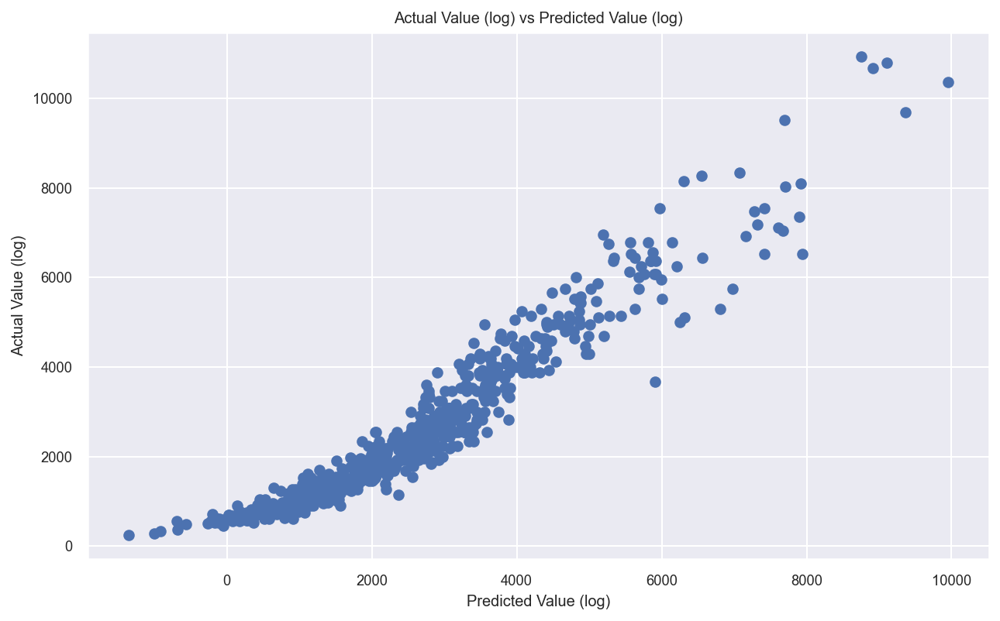

In [1044]:
plt.figure(figsize=(10,6),dpi=150),
lr = LinearRegression()
fit = lr.fit(X_test_arr,y_test);
pred = lr.predict(X_test_arr)
plt.scatter(pred,y_test)
plt.title("Actual Value (log) vs Predicted Value (log)")
plt.xlabel("Predicted Value (log)")
plt.ylabel("Actual Value (log)")
plt.show()

### Random Forest (Cross Validation with Hyperparameter tuning)

In [1045]:
def print_metrics(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Squared error : %s" % mean_squared_error(y_test, y_pred))
    print("Mean Absolute error : %s" % mean_absolute_error(y_test, y_pred))
    print("R2 Score: %s" % r2_score(y_test, y_pred))

In [1046]:
#defining function to find out the feature importance
def feature_importance(model):
    return sorted(zip(feature_names, model.feature_importances_), key=lambda x : x[1], reverse=True)

In [1047]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error


In [1168]:
#Cross validation
rf = RandomForestRegressor()
kf = KFold(n_splits=10, shuffle=True, random_state = 42)
score_rf=cross_val_score(rf, X_train_arr, y_train.values.ravel(), cv=kf, scoring='r2')


In [1170]:
print("10-fold Cross_validation Accuracy:", score_rf.mean())


10-fold Cross_validation Accuracy: 0.9699896221926008


In [1172]:
rf_params = {'n_estimators' : [50, 100, 200], 'bootstrap' : [True, False], 
              'min_samples_split' : [0.1, 0.01, 0.001], 'max_depth' : [3, 5, 8],
              'max_features' : ['sqrt', 0.1, 0.01], 'warm_start' : [True, False]
          }
rsearch_rfr = RandomizedSearchCV(rf, rfr_params, cv=10, n_iter=10, n_jobs=5, scoring="r2", verbose=1, random_state=42)
rsearch_rfr.fit(X_train_arr, y_train.values.ravel())


Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomizedSearchCV(cv=10, estimator=RandomForestRegressor(), n_jobs=5,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [3, 5, 8],
                                        'max_features': ['sqrt', 0.1, 0.01],
                                        'min_samples_split': [0.1, 0.01, 0.001],
                                        'n_estimators': [50, 100, 200],
                                        'warm_start': [True, False]},
                   random_state=42, scoring='r2', verbose=1)

In [1174]:
pd.DataFrame(rsearch_rfr.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

,mean_test_score,std_test_score,params
0,0.921319,0.021852,"{'warm_start': True, 'n_estimators': 50, 'min_..."
1,0.827887,0.047301,"{'warm_start': True, 'n_estimators': 50, 'min_..."
2,0.922204,0.026939,"{'warm_start': False, 'n_estimators': 200, 'mi..."
3,0.857421,0.034300,"{'warm_start': False, 'n_estimators': 100, 'mi..."
4,0.793190,0.062995,"{'warm_start': True, 'n_estimators': 50, 'min_..."
5,0.824831,0.050442,"{'warm_start': True, 'n_estimators': 50, 'min_..."
6,0.852534,0.045128,"{'warm_start': False, 'n_estimators': 100, 'mi..."
7,0.838572,0.048789,"{'warm_start': True, 'n_estimators': 200, 'min..."
8,0.740092,0.061684,"{'warm_start': True, 'n_estimators': 100, 'min..."
9,0.709141,0.059897,"{'warm_start': True, 'n_estimators': 50, 'min_..."


In [1175]:
rsearch_rfr.best_score_

0.9222035977070062

In [1176]:
rsearch_rfr.best_estimator_


RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_split=0.01,
                      n_estimators=200)

In [1177]:
rsearch_rfr.best_params_


{'warm_start': False,
 'n_estimators': 200,
 'min_samples_split': 0.01,
 'max_features': 0.1,
 'max_depth': 8,
 'bootstrap': True}

## Final Model (Random Forest) Model: Prediction on Training and Test data<br>(Without popularity and wage data) 

In [1178]:
rfr_model=RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_split=0.01,
                      n_estimators=200,warm_start= False,bootstrap= True)


In [1179]:
rfr_model.fit(X_train_arr, y_train.values.ravel())


RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_split=0.01,
                      n_estimators=200)

#### Prediction on training data


In [1180]:
def print_metrics(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Squared error : %s" % mean_squared_error(y_test, y_pred))
    print("Mean Absolute error : %s" % mean_absolute_error(y_test, y_pred))
    print("R2 Score: %s" % r2_score(y_test, y_pred))

In [1181]:
print("Training Accuracy")
print_metrics(rfr_model, X_train_arr, y_train[labels])

Training Accuracy
Mean Squared error : 141385.27354198834
Mean Absolute error : 247.88459835521127
R2 Score: 0.9656265208669108


#### Prediction on test data


In [1182]:
print("Testing Accuracy")
print_metrics(rfr_model, X_test_arr, y_test[labels])

Testing Accuracy
Mean Squared error : 274478.34356790356
Mean Absolute error : 319.0626310014419
R2 Score: 0.9166974799358278


/var/folders/_y/xn3ctgpx2kq_z25wf8cn757r0000gn/T/ipykernel_1625/956173396.py:3: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



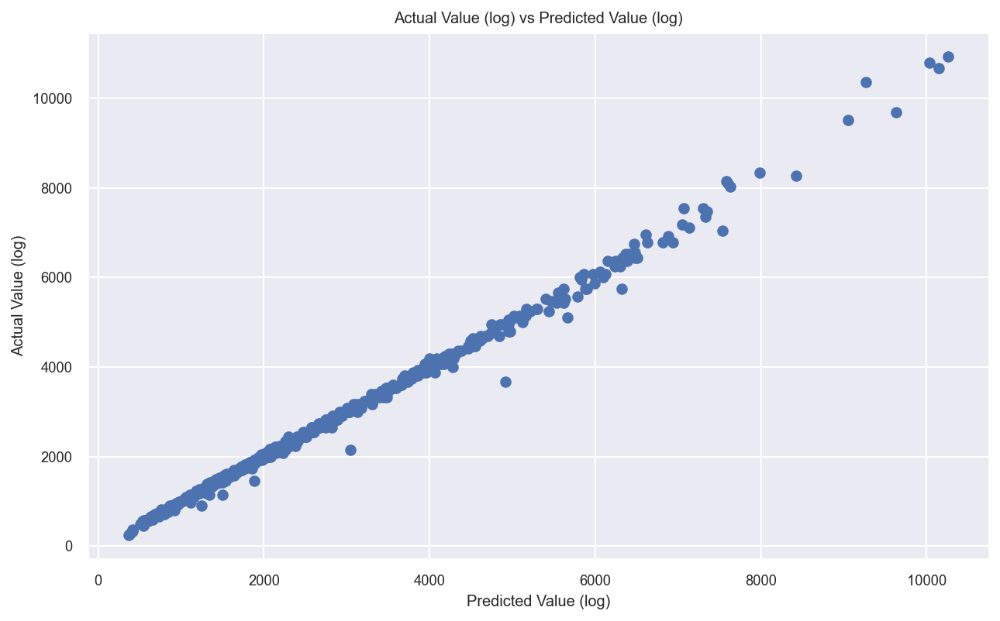

In [1063]:
plt.figure(figsize=(10,6),dpi=150),
rfr_model = RandomForestRegressor()
fit = rfr_model.fit(X_test_arr,y_test);
pred = rfr_model.predict(X_test_arr)
plt.scatter(pred,y_test)
plt.title("Actual Value (log) vs Predicted Value (log)")
plt.xlabel("Predicted Value (log)")
plt.ylabel("Actual Value (log)")
plt.show()

### Gradient Boosting (cross validation and hyperparameter tuning)

In [1390]:
#Cross validation
gb = GradientBoostingRegressor()
kf = KFold(n_splits=10, shuffle=True, random_state = 42)
cross_val_score(gb, X_train_arr, y_train.values.ravel(), cv=kf, scoring='r2')


array([0.97399904, 0.9692157 , 0.99267716, 0.99496433, 0.98856568,
       0.98214861, 0.98930561, 0.99363168, 0.95710114, 0.99182891])

In [1391]:
print(round(np.mean(cross_val_score(gb, X_train_arr, y_train.values.ravel(), cv=kf, scoring='r2')),5))

0.98422


In [1392]:
gb = GradientBoostingRegressor(n_iter_no_change=10)
params_gb = {'learning_rate' : [0.1, 0.01, 0.001], 'n_estimators' : [50, 100, 200],
           'subsample' : [0.8, 0.9, 1.0], 'min_samples_split' : [0.01, 0.001],
           'max_depth' : [3, 5, 8], 'max_features' : ['auto', 'sqrt', 'log2'],
          }
rsearch_gb = RandomizedSearchCV(gb, params_gb, cv=10, n_iter=10, n_jobs=10, scoring='r2', verbose=True, random_state=42)



In [1393]:
rsearch_gb.fit(X_train_arr, y_train.values.ravel())

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomizedSearchCV(cv=10,
                   estimator=GradientBoostingRegressor(n_iter_no_change=10),
                   n_jobs=10,
                   param_distributions={'learning_rate': [0.1, 0.01, 0.001],
                                        'max_depth': [3, 5, 8],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_split': [0.01, 0.001],
                                        'n_estimators': [50, 100, 200],
                                        'subsample': [0.8, 0.9, 1.0]},
                   random_state=42, scoring='r2', verbose=True)

In [1394]:
pd.DataFrame(rsearch_gb.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

,mean_test_score,std_test_score,params
0,0.255373,0.020463,"{'subsample': 0.8, 'n_estimators': 200, 'min_s..."
1,0.521666,0.031410,"{'subsample': 0.9, 'n_estimators': 50, 'min_sa..."
2,0.255048,0.021647,"{'subsample': 1.0, 'n_estimators': 200, 'min_s..."
3,0.303616,0.018503,"{'subsample': 0.9, 'n_estimators': 200, 'min_s..."
4,0.113476,0.019589,"{'subsample': 0.9, 'n_estimators': 100, 'min_s..."
5,0.281018,0.018116,"{'subsample': 0.8, 'n_estimators': 200, 'min_s..."
6,0.719977,0.030017,"{'subsample': 0.9, 'n_estimators': 100, 'min_s..."
7,0.595280,0.021884,"{'subsample': 0.8, 'n_estimators': 50, 'min_sa..."
8,0.943878,0.021588,"{'subsample': 1.0, 'n_estimators': 100, 'min_s..."
9,0.830789,0.020035,"{'subsample': 0.9, 'n_estimators': 100, 'min_s..."


In [1395]:
rsearch_gb.best_score_

0.9438781724704463

In [1396]:
rsearch_gb.best_estimator_

GradientBoostingRegressor(max_depth=5, max_features='log2',
                          min_samples_split=0.001, n_iter_no_change=10)

In [1397]:
rsearch_gb.best_params_

{'subsample': 1.0,
 'n_estimators': 100,
 'min_samples_split': 0.001,
 'max_features': 'log2',
 'max_depth': 5,
 'learning_rate': 0.1}

## Final Model (Gradient Boosting) Model: Prediction on Training and Test data<br>(Without popularity and wage data) 

In [1398]:
gbm_model=GradientBoostingRegressor(max_depth=5, max_features='log2',
                          min_samples_split=0.001, n_iter_no_change=10, learning_rate=0.1, n_estimators=100)

In [1399]:
gbm_model.fit(X_train_arr, y_train.values.ravel())


GradientBoostingRegressor(max_depth=5, max_features='log2',
                          min_samples_split=0.001, n_iter_no_change=10)

#### Prediction on Training data

In [1400]:
print("Training")
print_metrics(gbm_model, X_train_arr, y_train)

Training
Mean Squared error : 23064.239578028017
Mean Absolute error : 87.73328169623164
R2 Score: 0.9943926397849315


#### Prediction on Testing data

In [1401]:

print("Testing")
print_metrics(gbm_model, X_test_arr, y_test[labels])

Testing
Mean Squared error : 171890.18001641627
Mean Absolute error : 237.3471517880873
R2 Score: 0.9478323681805909


/Users/swapnilsrivastava/Documents/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



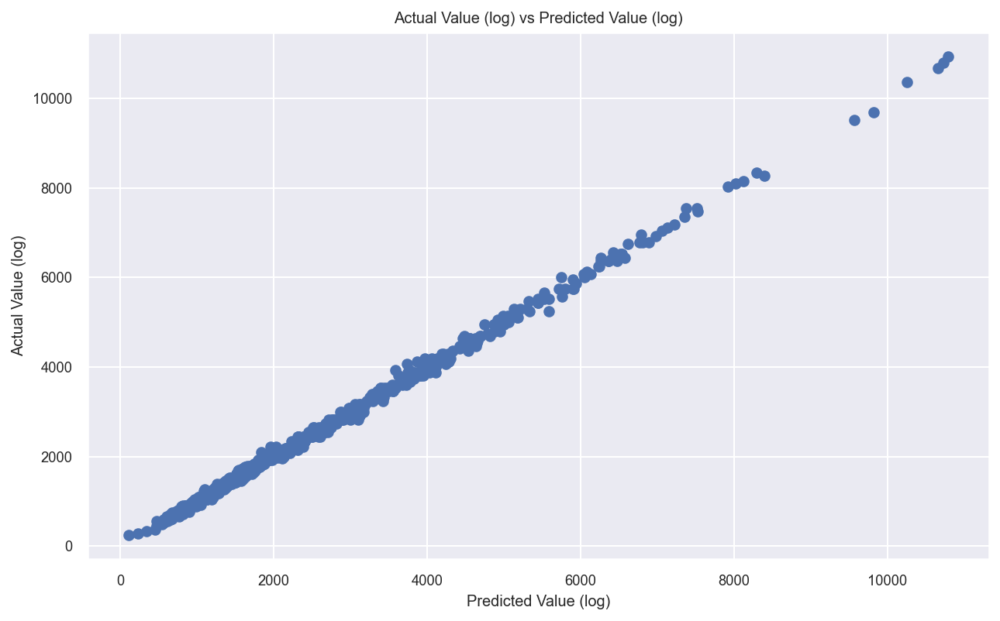

In [1402]:
plt.figure(figsize=(10,6),dpi=150),
gbm_model = GradientBoostingRegressor()
fit = gbm_model.fit(X_test_arr,y_test);
pred = gbm_model.predict(X_test_arr)
plt.scatter(pred,y_test)
plt.title("Actual Value (log) vs Predicted Value (log)")
plt.xlabel("Predicted Value (log)")
plt.ylabel("Actual Value (log)")
plt.show()

## --------------------------------------------------------------------------------------------------------------

## Models (with only popularity data)

#### Splitting the data in Train and Test Set

In [1312]:
#Splitting the data in training and testing data in 70:30 ratio
from sklearn.model_selection import train_test_split
train, test = train_test_split(df_pop, test_size=0.4, random_state=2)

In [1313]:
labels = ['value_eur']
X_train, X_test = (X.drop(labels=labels, axis=1, inplace=False) for X in (train, test)) #X_train and X_test contains all the feature columns except the label/target column 
y_train, y_test = (X[labels].copy() for X in (train, test)) #Y_train and Y_test contains the label/target column


In [1314]:
y_test.columns

Index(['value_eur'], dtype='object')

We'll use one-hot encoding for the categorical features as they are not ordinal

In [1315]:
#divinding the training features into categorical and numeric columns to perform one hot encoding
cat_columns = X_train.select_dtypes('object', 'category').columns
num_columns = X_train.select_dtypes(exclude=['object', 'category']).columns

In [1316]:
cat_columns

Index(['preferred_foot', 'work_rate1', 'work_rate2', 'body_type1'], dtype='object')

In [1317]:
num_columns

Index(['sofifa_id', 'overall', 'potential', 'wage_eur', 'age', 'height_cm',
       'weight_kg', 'club_team_id', 'club_contract_valid_until',
       'nationality_id', 'weak_foot', 'skill_moves',
       'international_reputation', 'lw', 'lf', 'cf', 'rf', 'rw',
       'Wikipedia_Views', 'ls1', 'ls2', 'st2', 'rs2', 'lam2', 'lm2', 'lcm1',
       'lcm2', 'cm1', 'cm2', 'rcm1', 'rcm2', 'lwb2', 'ldm2', 'cdm2', 'rdm2',
       'rwb2', 'lb2', 'lcb2', 'cb2', 'rcb2', 'rb2', 'gk1', 'gk2',
       'League_name_code', 'pace_new', 'passing_new', 'shooting_new',
       'defending_new', 'dribbling_new', 'physical_new', 'goalkeeping_new'],
      dtype='object')

Now, we'll create a pipeline to process Categorical features (using one-hot encoding) & Numeric features (using Imputation & feature scaling)

In [1318]:
#We'll use one-hot encoding for the categorical features since they are mostly not ordinal and for numerical columns we will do the standard scaling
from sklearn.base import BaseEstimator, TransformerMixin
class DataFrameSelector(BaseEstimator, TransformerMixin):
    def __init__(self, feature_names):
        self.feature_names = feature_names
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return X[self.feature_names].values
    def get_feature_names(self):
        return self.feature_names

#### ONE HOT ENCODING FOR CATEGORICAL COLUMNS

In [1319]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
cat_selector = DataFrameSelector(cat_columns)
ohe = OneHotEncoder(sparse=False, handle_unknown='ignore')
cat_pipeline = Pipeline([
    ('selector', cat_selector),
    ('ohe', ohe)
])


#### STANDARDIZATION OF NUMERICAL COLUMNS

In [1320]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
num_selector = DataFrameSelector(num_columns)
num_pipeline = Pipeline([
    ('selector', num_selector),
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

In [1321]:
from sklearn.pipeline import FeatureUnion
pipeline = FeatureUnion([
    ('cat_pipeline', cat_pipeline),
    ('num_pipeline', num_pipeline)
])

In [1322]:
pipeline

FeatureUnion(transformer_list=[('cat_pipeline',
                                Pipeline(steps=[('selector',
                                                 DataFrameSelector(feature_names=Index(['preferred_foot', 'work_rate1', 'work_rate2', 'body_type1'], dtype='object'))),
                                                ('ohe',
                                                 OneHotEncoder(handle_unknown='ignore',
                                                               sparse=False))])),
                               ('num_pipeline',
                                Pipeline(steps=[('selector',
                                                 DataFrameSelector(feature_names=Index(['sofifa_id', 'ov...
       'Wikipedia_Views', 'ls1', 'ls2', 'st2', 'rs2', 'lam2', 'lm2', 'lcm1',
       'lcm2', 'cm1', 'cm2', 'rcm1', 'rcm2', 'lwb2', 'ldm2', 'cdm2', 'rdm2',
       'rwb2', 'lb2', 'lcb2', 'cb2', 'rcb2', 'rb2', 'gk1', 'gk2',
       'League_name_code', 'pace_new', 'passing_new', 'shoot

In [1323]:
#Performing the above operations on the training data
X_train_arr = pipeline.fit_transform(X_train)
X_train_arr

array([[ 0.        ,  1.        ,  0.        , ...,  0.79674127,
         1.23691754, -0.38675128],
       [ 0.        ,  1.        ,  0.        , ..., -2.91822896,
        -2.21553946,  2.30052045],
       [ 1.        ,  0.        ,  1.        , ...,  1.03929946,
         0.8790409 , -0.31843081],
       ...,
       [ 0.        ,  1.        ,  0.        , ...,  0.6307804 ,
        -0.06827961, -0.32981755],
       [ 0.        ,  1.        ,  0.        , ..., -1.37351625,
        -1.60504401,  2.99321408],
       [ 1.        ,  0.        ,  0.        , ...,  0.29885866,
         0.03697822, -0.31843081]])

In [1324]:
feature_names = list(ohe.get_feature_names_out()) + list(num_selector.get_feature_names())

In [1325]:
feature_names

['x0_Left',
 'x0_Right',
 'x1_High',
 'x1_Low',
 'x1_Medium',
 'x2_High',
 'x2_Low',
 'x2_Medium',
 'x3_Lean',
 'x3_Normal',
 'x3_Stocky',
 'x3_Unique',
 'sofifa_id',
 'overall',
 'potential',
 'wage_eur',
 'age',
 'height_cm',
 'weight_kg',
 'club_team_id',
 'club_contract_valid_until',
 'nationality_id',
 'weak_foot',
 'skill_moves',
 'international_reputation',
 'lw',
 'lf',
 'cf',
 'rf',
 'rw',
 'Wikipedia_Views',
 'ls1',
 'ls2',
 'st2',
 'rs2',
 'lam2',
 'lm2',
 'lcm1',
 'lcm2',
 'cm1',
 'cm2',
 'rcm1',
 'rcm2',
 'lwb2',
 'ldm2',
 'cdm2',
 'rdm2',
 'rwb2',
 'lb2',
 'lcb2',
 'cb2',
 'rcb2',
 'rb2',
 'gk1',
 'gk2',
 'League_name_code',
 'pace_new',
 'passing_new',
 'shooting_new',
 'defending_new',
 'dribbling_new',
 'physical_new',
 'goalkeeping_new']

In [1326]:
pd.set_option('display.max_columns', None)

In [1327]:
finaldf.head()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st2,rs2,lam2,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,lwb2,ldm2,cdm2,rdm2,rwb2,lb2,lcb2,cb2,rcb2,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new,body_type1
0,158023,93,93,8831.760866,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,92.0,93.0,93.0,93.0,92.0,1072960.0,78000000.0,Medium,Low,89.0,3.0,3.0,3.0,1.0,2.0,87.0,3.0,87.0,3.0,87.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8,Unique
1,188545,92,92,10931.605555,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,85.0,88.0,88.0,88.0,85.0,264938.0,119500000.0,High,Medium,90.0,2.0,2.0,2.0,3.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2,Unique
2,20801,91,91,6708.203932,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,88.0,89.0,89.0,89.0,88.0,1642013.0,45000000.0,High,Low,90.0,1.0,1.0,1.0,3.0,3.0,78.0,3.0,78.0,3.0,78.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6,Unique
3,231747,91,95,13928.388277,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,90.0,90.0,90.0,90.0,90.0,307816.0,194000000.0,High,Low,83.0,3.0,3.0,3.0,2.0,2.0,82.0,3.0,82.0,3.0,82.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4,Unique
4,192985,91,91,11202.678251,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,88.0,87.0,87.0,87.0,88.0,135087.0,125500000.0,High,High,83.0,3.0,3.0,3.0,2.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2,Unique


### Pipelining

In [1328]:
#Performing normalization and one hot encoding on test data as well
X_test_arr = pipeline.transform(X_test)
X_test_arr

array([[ 1.        ,  0.        ,  0.        , ..., -0.4798808 ,
         0.96324717, -0.37536453],
       [ 0.        ,  1.        ,  1.        , ...,  1.09036435,
         1.19481441, -0.39813802],
       [ 1.        ,  0.        ,  1.        , ...,  0.08183291,
        -0.53141409, -0.443685  ],
       ...,
       [ 0.        ,  1.        ,  0.        , ...,  0.47758575,
        -0.38405312, -0.38675128],
       [ 1.        ,  0.        ,  0.        , ..., -0.49264702,
         0.77378307, -0.27288383],
       [ 0.        ,  1.        ,  0.        , ..., -1.78203532,
        -1.2892705 ,  2.6800786 ]])

In [560]:
finaldf.to_excel(r'/Users/swapnilsrivastava/Desktop/modeldata.xlsx', index = False)

## Base Model(Linear Regression)

In [1329]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from sklearn.linear_model import LinearRegression

In [1330]:
lr = LinearRegression()
kf = KFold(n_splits=10, shuffle=True, random_state = 10)
cross_val_score(lr, X_train_arr, y_train, cv=kf, scoring='r2')


array([0.92023831, 0.94751812, 0.90639299, 0.90614811, 0.88281097,
       0.93992566, 0.85880977, 0.93433627, 0.89976339, 0.91150297])

In [1331]:
print(round(np.mean(cross_val_score(lr, X_train_arr, y_train, cv=kf, scoring='r2')),5))

0.91074


In [1332]:
def print_metrics(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Squared error : %s" % mean_squared_error(y_test, y_pred))
    print("Mean Absolute error : %s" % mean_absolute_error(y_test, y_pred))
    print("R2 Score: %s" % r2_score(y_test, y_pred))

In [1333]:
lr.fit(X_train_arr, y_train)

LinearRegression()

In [1334]:
print_metrics(lr, X_train_arr, y_train)


Mean Squared error : 282001.63141913543
Mean Absolute error : 381.7766349184834
R2 Score: 0.926131671175364


In [1335]:
lr.fit(X_test_arr, y_test)

LinearRegression()

In [1336]:
print_metrics(lr, X_test_arr, y_test)


Mean Squared error : 227086.10413838978
Mean Absolute error : 359.26498429529624
R2 Score: 0.9392869165789278


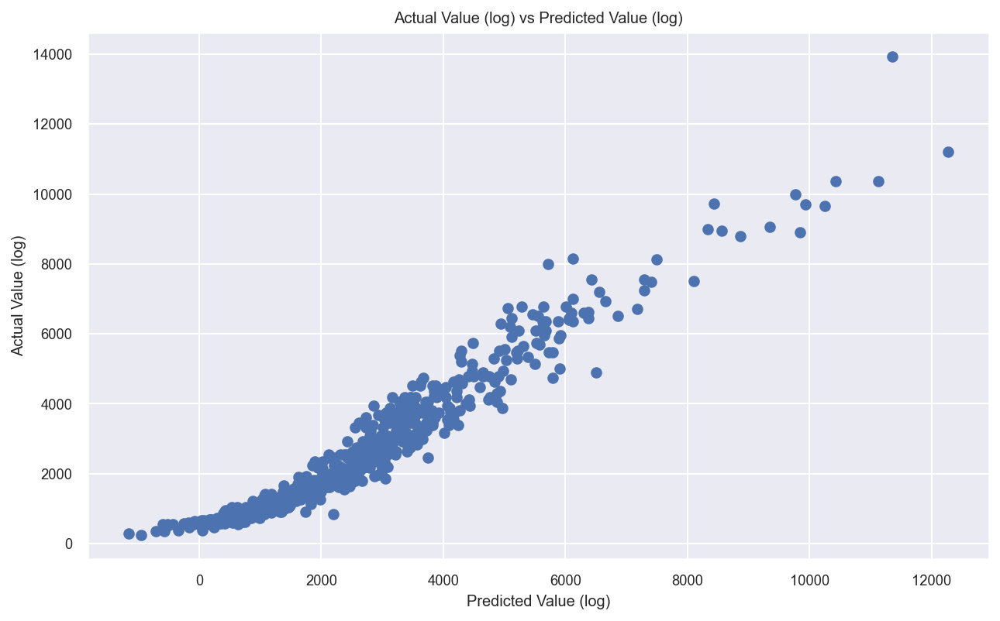

In [1337]:
plt.figure(figsize=(10,6),dpi=150),
lr = LinearRegression()
fit = lr.fit(X_test_arr,y_test);
pred =lr.predict(X_test_arr)
plt.scatter(pred,y_test)
plt.title("Actual Value (log) vs Predicted Value (log)")
plt.xlabel("Predicted Value (log)")
plt.ylabel("Actual Value (log)")
plt.show()

### Random Forest (Cross Validation with Hyperparameter tuning)

In [1340]:
def print_metrics(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Squared error : %s" % mean_squared_error(y_test, y_pred))
    print("Mean Absolute error : %s" % mean_absolute_error(y_test, y_pred))
    print("R2 Score: %s" % r2_score(y_test, y_pred))

In [1341]:
#defining function to find out the feature importance
def feature_importance(model):
    return sorted(zip(feature_names, model.feature_importances_), key=lambda x : x[1], reverse=True)

In [1343]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error


In [1344]:
rf = RandomForestRegressor()
kf = KFold(n_splits=10, shuffle=True, random_state = 10)
rf_score=cross_val_score(lr, X_train_arr, y_train, cv=kf, scoring='r2')


In [1345]:
print("10-fold Cross_validation Accuracy:", rf_score.mean())


10-fold Cross_validation Accuracy: 0.910744654089801


In [1346]:
from sklearn.model_selection import cross_val_predict, cross_val_score, GridSearchCV, RandomizedSearchCV
rfr = RandomForestRegressor()
rfr_params = {'n_estimators' : [50, 100, 200], 'bootstrap' : [True, False], 
              'min_samples_split' : [0.1, 0.01, 0.001], 'max_depth' : [3, 5, 8],
              'max_features' : ['sqrt', 0.1, 0.01], 'warm_start' : [True, False]
          }
rsearch_rfr = RandomizedSearchCV(rfr, rfr_params, cv=10, n_iter=10, n_jobs=5, scoring="r2", verbose=1, random_state=42)
rsearch_rfr.fit(X_train_arr, y_train.values.ravel())


Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomizedSearchCV(cv=10, estimator=RandomForestRegressor(), n_jobs=5,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [3, 5, 8],
                                        'max_features': ['sqrt', 0.1, 0.01],
                                        'min_samples_split': [0.1, 0.01, 0.001],
                                        'n_estimators': [50, 100, 200],
                                        'warm_start': [True, False]},
                   random_state=42, scoring='r2', verbose=1)

In [1347]:
pd.DataFrame(rsearch_rfr.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

,mean_test_score,std_test_score,params
0,0.915910,0.022904,"{'warm_start': True, 'n_estimators': 50, 'min_..."
1,0.830278,0.035624,"{'warm_start': True, 'n_estimators': 50, 'min_..."
2,0.916468,0.021203,"{'warm_start': False, 'n_estimators': 200, 'mi..."
3,0.842869,0.029107,"{'warm_start': False, 'n_estimators': 100, 'mi..."
4,0.793030,0.037876,"{'warm_start': True, 'n_estimators': 50, 'min_..."
5,0.821678,0.037708,"{'warm_start': True, 'n_estimators': 50, 'min_..."
6,0.848258,0.032633,"{'warm_start': False, 'n_estimators': 100, 'mi..."
7,0.824928,0.036142,"{'warm_start': True, 'n_estimators': 200, 'min..."
8,0.730476,0.052200,"{'warm_start': True, 'n_estimators': 100, 'min..."
9,0.703015,0.040723,"{'warm_start': True, 'n_estimators': 50, 'min_..."


In [1348]:
rsearch_rfr.best_score_

0.9164678215133988

In [1349]:
rsearch_rfr.best_estimator_


RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_split=0.01,
                      n_estimators=200)

In [1350]:
rsearch_rfr.best_params_


{'warm_start': False,
 'n_estimators': 200,
 'min_samples_split': 0.01,
 'max_features': 0.1,
 'max_depth': 8,
 'bootstrap': True}

## Final Model (Random Forest) Model: Prediction on Training and Test data<br>(With popularity data) 

In [1351]:
rfr_model=RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_split=0.01,
                      n_estimators=200,warm_start= False,bootstrap= True)


In [1352]:
rfr_model.fit(X_train_arr, y_train.values.ravel())


RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_split=0.01,
                      n_estimators=200)

#### Prediction on training data


In [1353]:
def print_metrics(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Squared error : %s" % mean_squared_error(y_test, y_pred))
    print("Mean Absolute error : %s" % mean_absolute_error(y_test, y_pred))
    print("R2 Score: %s" % r2_score(y_test, y_pred))

In [1354]:
print("Training Accuracy")
print_metrics(rfr_model, X_train_arr, y_train[labels])

Training Accuracy
Mean Squared error : 137359.02553051972
Mean Absolute error : 240.48091789372864
R2 Score: 0.9640197767159744


#### Prediction on test data


In [1355]:
print("Testing Accuracy")
print_metrics(rfr_model, X_test_arr, y_test[labels])

Testing Accuracy
Mean Squared error : 244593.06806109485
Mean Absolute error : 307.13205582407545
R2 Score: 0.9346063053846773


/var/folders/_y/xn3ctgpx2kq_z25wf8cn757r0000gn/T/ipykernel_1625/3551549861.py:3: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



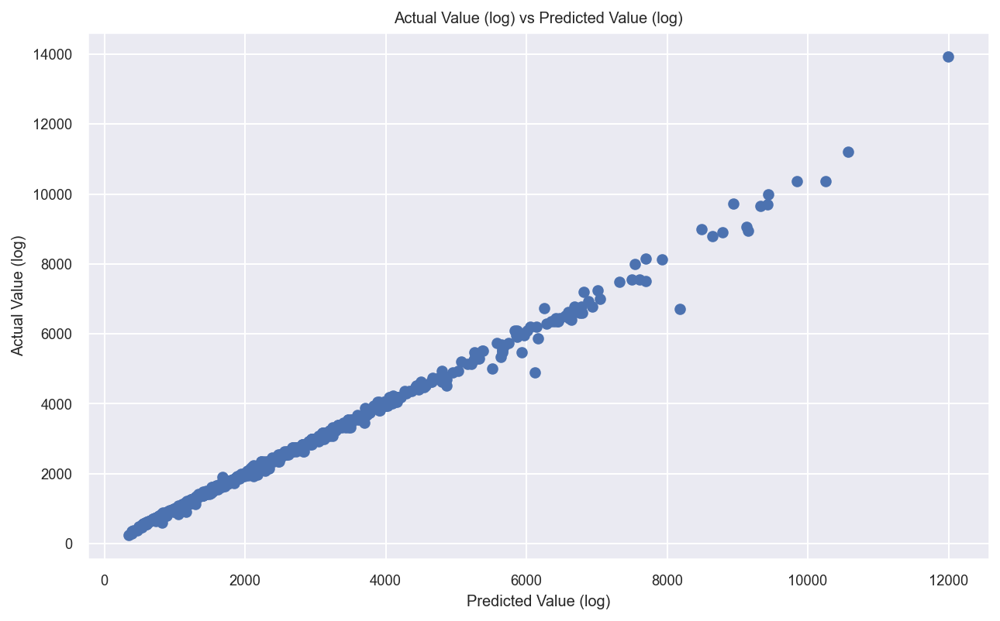

In [1356]:
plt.figure(figsize=(10,6),dpi=150),
rfr_model = RandomForestRegressor()
fit = rfr_model.fit(X_test_arr,y_test);
pred =rfr_model.predict(X_test_arr)
plt.scatter(pred,y_test)
plt.title("Actual Value (log) vs Predicted Value (log)")
plt.xlabel("Predicted Value (log)")
plt.ylabel("Actual Value (log)")
plt.show()

### Gradient Boosting (cross validation and hyperparameter tuning)

In [1357]:
gb = GradientBoostingRegressor()
kf = KFold(n_splits=10, shuffle=True, random_state = 10)
score_gb=cross_val_score(lr, X_train_arr, y_train, cv=kf, scoring='r2')



In [1358]:
print("10-fold Cross_validation R Square Value:", score_gb.mean())

10-fold Cross_validation R Square Value: 0.910744654089801


In [1359]:
gbm = GradientBoostingRegressor(n_iter_no_change=10)
params_gb = {'learning_rate' : [0.1, 0.01, 0.001], 'n_estimators' : [50, 100, 200],
           'subsample' : [0.8, 0.9, 1.0], 'min_samples_split' : [0.01, 0.001],
           'max_depth' : [3, 5, 8], 'max_features' : ['auto', 'sqrt', 'log2'],
          }
rsearch_gb = RandomizedSearchCV(gbm, params_gb, cv=10, n_iter=10, n_jobs=10, scoring='r2', verbose=True, random_state=42)



In [1360]:
rsearch_gb.fit(X_train_arr, y_train.values.ravel())

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomizedSearchCV(cv=10,
                   estimator=GradientBoostingRegressor(n_iter_no_change=10),
                   n_jobs=10,
                   param_distributions={'learning_rate': [0.1, 0.01, 0.001],
                                        'max_depth': [3, 5, 8],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_split': [0.01, 0.001],
                                        'n_estimators': [50, 100, 200],
                                        'subsample': [0.8, 0.9, 1.0]},
                   random_state=42, scoring='r2', verbose=True)

In [1361]:
pd.DataFrame(rsearch_gb.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

,mean_test_score,std_test_score,params
0,0.255376,0.012384,"{'subsample': 0.8, 'n_estimators': 200, 'min_s..."
1,0.519569,0.020419,"{'subsample': 0.9, 'n_estimators': 50, 'min_sa..."
2,0.257377,0.011726,"{'subsample': 1.0, 'n_estimators': 200, 'min_s..."
3,0.308701,0.017503,"{'subsample': 0.9, 'n_estimators': 200, 'min_s..."
4,0.117170,0.006802,"{'subsample': 0.9, 'n_estimators': 100, 'min_s..."
5,0.282788,0.013223,"{'subsample': 0.8, 'n_estimators': 200, 'min_s..."
6,0.707358,0.023173,"{'subsample': 0.9, 'n_estimators': 100, 'min_s..."
7,0.600978,0.021991,"{'subsample': 0.8, 'n_estimators': 50, 'min_sa..."
8,0.943440,0.013365,"{'subsample': 1.0, 'n_estimators': 100, 'min_s..."
9,0.830578,0.024995,"{'subsample': 0.9, 'n_estimators': 100, 'min_s..."


In [1362]:
rsearch_gb.best_score_

0.9434402828135784

In [1363]:
rsearch_gb.best_estimator_

GradientBoostingRegressor(max_depth=5, max_features='log2',
                          min_samples_split=0.001, n_iter_no_change=10)

In [1364]:
rsearch_gb.best_params_

{'subsample': 1.0,
 'n_estimators': 100,
 'min_samples_split': 0.001,
 'max_features': 'log2',
 'max_depth': 5,
 'learning_rate': 0.1}

##  Final Model (Gradient Boosting) Model: Prediction on Training and Test data<br>(With popularity data) 

In [1365]:
gbm_model=GradientBoostingRegressor(max_depth=5, max_features='log2',
                          min_samples_split=0.001, n_iter_no_change=10)

In [1366]:
gbm_model.fit(X_train_arr, y_train.values.ravel())


GradientBoostingRegressor(max_depth=5, max_features='log2',
                          min_samples_split=0.001, n_iter_no_change=10)

#### Prediction on Training data

In [1367]:
print("Training")
print_metrics(gbm_model, X_train_arr, y_train)

Training
Mean Squared error : 35198.05474536428
Mean Absolute error : 95.77232764770403
R2 Score: 0.990780119005575


#### Prediction on Testing data

In [1368]:

print("Testing")
print_metrics(gbm_model, X_test_arr, y_test[labels])

Testing
Mean Squared error : 190688.76710952216
Mean Absolute error : 251.21299004880024
R2 Score: 0.949018003241949


/Users/swapnilsrivastava/Documents/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



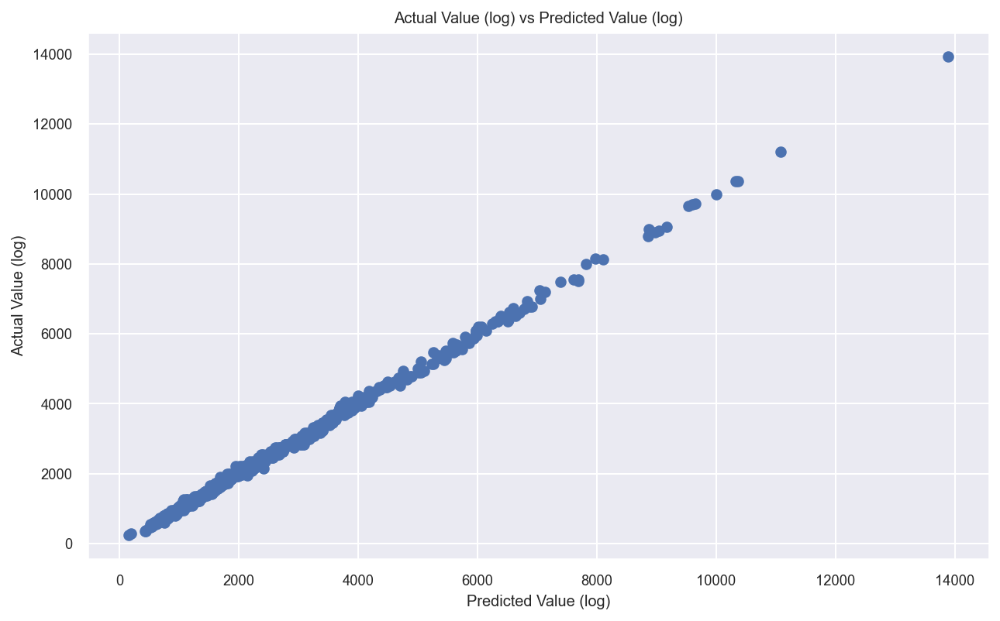

In [1369]:
plt.figure(figsize=(10,6),dpi=150),
gbm_model = GradientBoostingRegressor()
fit = gbm_model.fit(X_test_arr,y_test);
pred =gbm_model.predict(X_test_arr)
plt.scatter(pred,y_test)
plt.title("Actual Value (log) vs Predicted Value (log)")
plt.xlabel("Predicted Value (log)")
plt.ylabel("Actual Value (log)")
plt.show()

### ----------------------------------------------------------------------------------------------------------------------------------

## Models (With Popularity and wage data)<br>
Data Preparation for Model Implementation

### Splitting the data in Train and Test Set

In [1438]:
#Splitting the data in training and testing data in 60:40 ratio
from sklearn.model_selection import train_test_split
train, test = train_test_split(finaldf, test_size=0.4, random_state=42)

In [1439]:

labels = ['value_eur']
X_train, X_test = (X.drop(labels=labels, axis=1, inplace=False) for X in (train, test)) #X_train and X_test contains all the feature columns except the label/target column 
y_train, y_test = (X[labels].copy() for X in (train, test)) #Y_train and Y_test contains the label/target column


In [1440]:
y_test.columns

Index(['value_eur'], dtype='object')

We'll use one-hot encoding for the categorical features as they are not ordinal

In [1441]:
#divinding the training features into categorical and numeric columns to perform one hot encoding
cat_columns = X_train.select_dtypes('object', 'category').columns
num_columns = X_train.select_dtypes(exclude=['object', 'category']).columns

In [1408]:
cat_columns

Index(['preferred_foot', 'work_rate1', 'work_rate2', 'body_type1'], dtype='object')

In [1409]:
num_columns

Index(['sofifa_id', 'overall', 'potential', 'wage_eur', 'age', 'height_cm',
       'weight_kg', 'club_team_id', 'club_contract_valid_until',
       'nationality_id', 'weak_foot', 'skill_moves',
       'international_reputation', 'lw', 'lf', 'cf', 'rf', 'rw',
       'Wikipedia_Views', 'wage_avg', 'ls1', 'ls2', 'st2', 'rs2', 'lam2',
       'lm2', 'lcm1', 'lcm2', 'cm1', 'cm2', 'rcm1', 'rcm2', 'lwb2', 'ldm2',
       'cdm2', 'rdm2', 'rwb2', 'lb2', 'lcb2', 'cb2', 'rcb2', 'rb2', 'gk1',
       'gk2', 'League_name_code', 'pace_new', 'passing_new', 'shooting_new',
       'defending_new', 'dribbling_new', 'physical_new', 'goalkeeping_new'],
      dtype='object')

Now, we'll create a pipeline to process Categorical features (using one-hot encoding) & Numeric features (using Imputation & feature scaling)

In [1442]:
#We'll use one-hot encoding for the categorical features since they are mostly not ordinal and for numerical columns we will do the standard scaling
from sklearn.base import BaseEstimator, TransformerMixin
class DataFrameSelector(BaseEstimator, TransformerMixin):
    def __init__(self, feature_names):
        self.feature_names = feature_names
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return X[self.feature_names].values
    def get_feature_names(self):
        return self.feature_names

#### ONE HOT ENCODING FOR CATEGORICAL COLUMNS

In [1443]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
cat_selector = DataFrameSelector(cat_columns)
ohe = OneHotEncoder(sparse=False, handle_unknown='ignore')
cat_pipeline = Pipeline([
    ('selector', cat_selector),
    ('ohe', ohe)
])


#### STANDARDIZATION OF NUMERICAL COLUMNS

In [1444]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
num_selector = DataFrameSelector(num_columns)
num_pipeline = Pipeline([
    ('selector', num_selector),
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

In [1449]:
from sklearn.pipeline import FeatureUnion
pipeline = FeatureUnion([
    ('cat_pipeline', cat_pipeline),
    ('num_pipeline', num_pipeline)
])

In [1450]:
pipeline

FeatureUnion(transformer_list=[('cat_pipeline',
                                Pipeline(steps=[('selector',
                                                 DataFrameSelector(feature_names=Index(['preferred_foot', 'work_rate1', 'work_rate2', 'body_type1'], dtype='object'))),
                                                ('ohe',
                                                 OneHotEncoder(handle_unknown='ignore',
                                                               sparse=False))])),
                               ('num_pipeline',
                                Pipeline(steps=[('selector',
                                                 DataFrameSelector(feature_names=Index(['sofifa_id', 'ov...
       'Wikipedia_Views', 'wage_avg', 'ls1', 'ls2', 'st2', 'rs2', 'lam2',
       'lm2', 'lcm1', 'lcm2', 'cm1', 'cm2', 'rcm1', 'rcm2', 'lwb2', 'ldm2',
       'cdm2', 'rdm2', 'rwb2', 'lb2', 'lcb2', 'cb2', 'rcb2', 'rb2', 'gk1',
       'gk2', 'League_name_code', 'pace_new', 'passing_

In [1451]:
#Performing the above operations on the training data
X_train_arr = pipeline.fit_transform(X_train)
X_train_arr

array([[ 0.        ,  1.        ,  1.        , ...,  0.61080304,
         0.6311525 , -0.37786723],
       [ 0.        ,  1.        ,  0.        , ...,  0.42506475,
         0.15322069, -0.43289519],
       [ 0.        ,  1.        ,  1.        , ..., -0.26835821,
        -1.34291368, -0.36686164],
       ...,
       [ 0.        ,  1.        ,  0.        , ...,  0.70986346,
         0.07010211, -0.48792315],
       [ 1.        ,  0.        ,  0.        , ..., -1.48184837,
         0.13244105, -0.30082809],
       [ 0.        ,  1.        ,  1.        , ..., -0.50362671,
         1.21298253, -0.33384486]])

In [1452]:
feature_names = list(ohe.get_feature_names_out()) + list(num_selector.get_feature_names())

In [1453]:
feature_names

['x0_Left',
 'x0_Right',
 'x1_High',
 'x1_Low',
 'x1_Medium',
 'x2_High',
 'x2_Low',
 'x2_Medium',
 'x3_Lean',
 'x3_Normal',
 'x3_Stocky',
 'x3_Unique',
 'sofifa_id',
 'overall',
 'potential',
 'wage_eur',
 'age',
 'height_cm',
 'weight_kg',
 'club_team_id',
 'club_contract_valid_until',
 'nationality_id',
 'weak_foot',
 'skill_moves',
 'international_reputation',
 'lw',
 'lf',
 'cf',
 'rf',
 'rw',
 'Wikipedia_Views',
 'wage_avg',
 'ls1',
 'ls2',
 'st2',
 'rs2',
 'lam2',
 'lm2',
 'lcm1',
 'lcm2',
 'cm1',
 'cm2',
 'rcm1',
 'rcm2',
 'lwb2',
 'ldm2',
 'cdm2',
 'rdm2',
 'rwb2',
 'lb2',
 'lcb2',
 'cb2',
 'rcb2',
 'rb2',
 'gk1',
 'gk2',
 'League_name_code',
 'pace_new',
 'passing_new',
 'shooting_new',
 'defending_new',
 'dribbling_new',
 'physical_new',
 'goalkeeping_new']

In [1418]:
pd.set_option('display.max_columns', None)

In [1419]:
finaldf.head()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,club_position,club_contract_valid_until,nationality_id,preferred_foot,weak_foot,skill_moves,international_reputation,lw,lf,cf,rf,rw,Wikipedia_Views,wage_avg,work_rate1,work_rate2,ls1,ls2,st2,rs2,lam2,lm2,lcm1,lcm2,cm1,cm2,rcm1,rcm2,lwb2,ldm2,cdm2,rdm2,rwb2,lb2,lcb2,cb2,rcb2,rb2,gk1,gk2,League_name_code,pace_new,passing_new,shooting_new,defending_new,dribbling_new,physical_new,goalkeeping_new,body_type1
0,158023,93,93,8831.760866,320000,34,170,72,73,ATTACKER,2023,52,Left,4,4,5,92.0,93.0,93.0,93.0,92.0,1072960.0,78000000.0,Medium,Low,89.0,3.0,3.0,3.0,1.0,2.0,87.0,3.0,87.0,3.0,87.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,19.0,3.0,1,85.5,91.500000,88.500000,37.8,94.666667,63.25,10.8,Unique
1,188545,92,92,10931.605555,270000,32,185,81,21,ATTACKER,2023,37,Right,4,4,5,85.0,88.0,88.0,88.0,85.0,264938.0,119500000.0,High,Medium,90.0,2.0,2.0,2.0,3.0,3.0,80.0,3.0,80.0,3.0,80.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,19.0,3.0,2,78.0,78.500000,91.000000,47.0,85.500000,82.00,10.2,Unique
2,20801,91,91,6708.203932,270000,36,187,83,11,ATTACKER,2023,38,Right,4,5,5,88.0,89.0,89.0,89.0,88.0,1642013.0,45000000.0,High,Low,90.0,1.0,1.0,1.0,3.0,3.0,78.0,3.0,78.0,3.0,78.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,20.0,3.0,0,86.5,80.833333,91.833333,39.8,87.500000,78.00,11.6,Unique
3,231747,91,95,13928.388277,230000,22,182,73,73,ATTACKER,2022,18,Right,4,5,4,90.0,90.0,90.0,90.0,90.0,307816.0,194000000.0,High,Low,83.0,3.0,3.0,3.0,2.0,2.0,82.0,3.0,82.0,3.0,82.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,20.0,3.0,1,97.0,77.500000,85.833333,40.4,90.000000,76.25,8.4,Unique
4,192985,91,91,11202.678251,350000,30,181,70,10,MIDFIELDER,2025,7,Right,5,4,4,88.0,87.0,87.0,87.0,88.0,135087.0,125500000.0,High,High,83.0,3.0,3.0,3.0,2.0,2.0,89.0,2.0,89.0,2.0,89.0,2.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,21.0,3.0,0,76.0,90.500000,86.166667,61.4,86.000000,75.50,11.2,Unique


#### Pipelining

In [1454]:
#Performing normalization and one hot encoding on test data as well
X_test_arr = pipeline.transform(X_test)
X_test_arr

array([[ 0.        ,  1.        ,  0.        , ..., -0.2435931 ,
        -1.59226941, -0.27881691],
       [ 0.        ,  1.        ,  0.        , ...,  0.30123922,
        -0.90654115, -0.33384486],
       [ 0.        ,  1.        ,  0.        , ..., -0.50362671,
         0.36101713, -0.41088401],
       ...,
       [ 0.        ,  1.        ,  0.        , ...,  0.59842048,
        -0.2208129 , -0.30082809],
       [ 0.        ,  1.        ,  1.        , ...,  0.80892388,
         1.62857541, -0.35585605],
       [ 1.        ,  0.        ,  0.        , ..., -2.11335856,
        -1.11433759,  2.84860536]])

In [560]:
finaldf.to_excel(r'/Users/swapnilsrivastava/Desktop/modeldata.xlsx', index = False)

## Base Model(Linear Regression)

In [1246]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from sklearn.linear_model import LinearRegression

In [1293]:
lr = LinearRegression()
kf = KFold(n_splits=10, shuffle=True, random_state = 10)
cross_val_score(lr, X_train_arr, y_train, cv=kf, scoring='r2')

print(round(np.mean(cross_val_score(lr, X_train_arr, y_train, cv=kf, scoring='r2')),5))

0.97437


In [1294]:
lr = LinearRegression()
lr.fit(X_train_arr, y_train)

LinearRegression()

In [1249]:
def print_metrics(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Squared error : %s" % mean_squared_error(y_test, y_pred))
    print("Mean Absolute error : %s" % mean_absolute_error(y_test, y_pred))
    print("R2 Score: %s" % r2_score(y_test, y_pred))

In [1295]:
print_metrics(lr, X_train_arr, y_train)


Mean Squared error : 79235.74017273243
Mean Absolute error : 214.1697866120452
R2 Score: 0.9783939442604913


In [1296]:
print_metrics(lr, X_test_arr, y_test)


Mean Squared error : 91308.36229807201
Mean Absolute error : 224.90398896045278
R2 Score: 0.9769520419476969


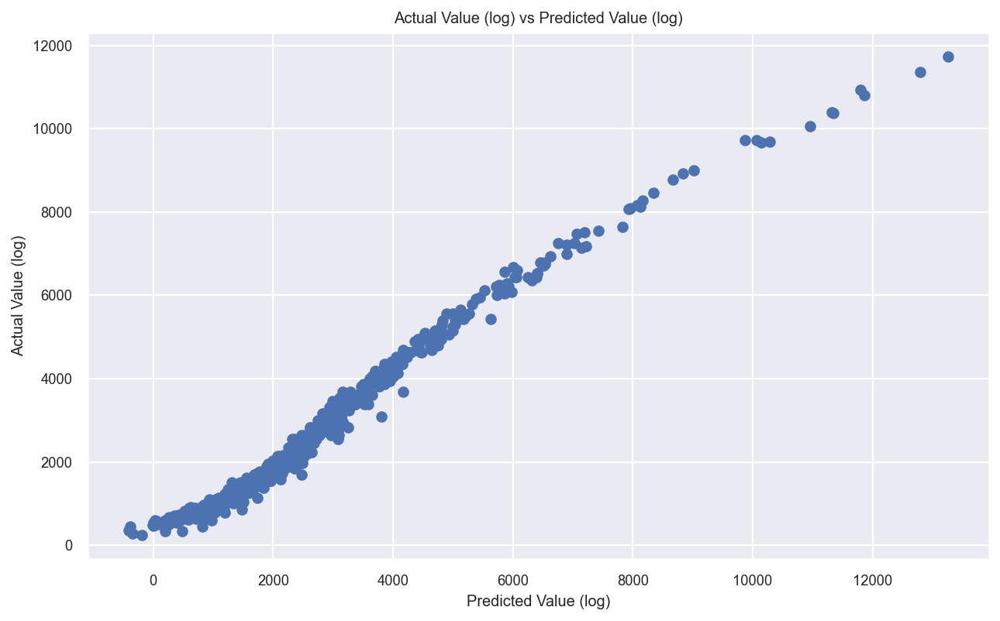

In [1309]:
plt.figure(figsize=(10,6),dpi=150),
lr = LinearRegression()
fit = lr.fit(X_test_arr,y_test);
pred =lr.predict(X_test_arr)
plt.scatter(pred,y_test)
plt.title("Actual Value (log) vs Predicted Value (log)")
plt.xlabel("Predicted Value (log)")
plt.ylabel("Actual Value (log)")
plt.show()

### Random Forest (Cross Validation with Hyperparameter tuning)

In [1252]:
def print_metrics(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Squared error : %s" % mean_squared_error(y_test, y_pred))
    print("Mean Absolute error : %s" % mean_absolute_error(y_test, y_pred))
    print("R2 Score: %s" % r2_score(y_test, y_pred))

In [1253]:
#defining function to find out the feature importance
def feature_importance(model):
    return sorted(zip(feature_names, model.feature_importances_), key=lambda x : x[1], reverse=True)

In [1254]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error


In [1258]:
rf = RandomForestRegressor()
kf = KFold(n_splits=10, shuffle=True, random_state = 10)
cross_val_score(lr, X_train_arr, y_train.values.ravel(), cv=kf, scoring='r2')



array([0.97810151, 0.97651801, 0.97424968, 0.97249893, 0.97575714,
       0.97176576, 0.97186793, 0.97828327, 0.97678628, 0.98007695])

In [1259]:
print(round(np.mean(cross_val_score(rf, X_train_arr, y_train.values.ravel(), cv=kf, scoring='r2')),5))

0.99944


In [1260]:
from sklearn.model_selection import cross_val_predict, cross_val_score, GridSearchCV, RandomizedSearchCV
rfr = RandomForestRegressor()
rfr_params = {'n_estimators' : [50, 100, 200], 'bootstrap' : [True, False], 
              'min_samples_split' : [0.1, 0.01, 0.001], 'max_depth' : [3, 5, 8],
              'max_features' : ['sqrt', 0.1, 0.01], 'warm_start' : [True, False]
          }
rsearch_rfr = RandomizedSearchCV(rfr, rfr_params, cv=10, n_iter=10, n_jobs=5, scoring="r2", verbose=1, random_state=42)
rsearch_rfr.fit(X_train_arr, y_train.values.ravel())


Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomizedSearchCV(cv=10, estimator=RandomForestRegressor(), n_jobs=5,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [3, 5, 8],
                                        'max_features': ['sqrt', 0.1, 0.01],
                                        'min_samples_split': [0.1, 0.01, 0.001],
                                        'n_estimators': [50, 100, 200],
                                        'warm_start': [True, False]},
                   random_state=42, scoring='r2', verbose=1)

In [1261]:
pd.DataFrame(rsearch_rfr.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

,mean_test_score,std_test_score,params
0,0.950118,0.013604,"{'warm_start': True, 'n_estimators': 50, 'min_..."
1,0.872795,0.039550,"{'warm_start': True, 'n_estimators': 50, 'min_..."
2,0.947871,0.015192,"{'warm_start': False, 'n_estimators': 200, 'mi..."
3,0.899083,0.018791,"{'warm_start': False, 'n_estimators': 100, 'mi..."
4,0.829786,0.041669,"{'warm_start': True, 'n_estimators': 50, 'min_..."
5,0.854775,0.028382,"{'warm_start': True, 'n_estimators': 50, 'min_..."
6,0.895820,0.023089,"{'warm_start': False, 'n_estimators': 100, 'mi..."
7,0.867852,0.024911,"{'warm_start': True, 'n_estimators': 200, 'min..."
8,0.756977,0.043882,"{'warm_start': True, 'n_estimators': 100, 'min..."
9,0.736817,0.032568,"{'warm_start': True, 'n_estimators': 50, 'min_..."


In [1262]:
rsearch_rfr.best_score_

0.950117776995058

In [1264]:
rsearch_rfr.best_estimator_


RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_split=0.01,
                      n_estimators=50, warm_start=True)

In [1265]:
rsearch_rfr.best_params_


{'warm_start': True,
 'n_estimators': 50,
 'min_samples_split': 0.01,
 'max_features': 0.1,
 'max_depth': 8,
 'bootstrap': True}


## Final Model (Random Forest) Model: Prediction on Training and Test data<br>(With popularity and wage data) 

In [1266]:
rfr_model=RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_split=0.01,
                      n_estimators=50,warm_start= True,bootstrap= True)


In [1267]:
rfr_model.fit(X_train_arr, y_train.values.ravel())


RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_split=0.01,
                      n_estimators=50, warm_start=True)

#### Prediction on training data


In [1268]:
def print_metrics(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Squared error : %s" % mean_squared_error(y_test, y_pred))
    print("Mean Absolute error : %s" % mean_absolute_error(y_test, y_pred))
    print("R2 Score: %s" % r2_score(y_test, y_pred))

In [1269]:
print("Training Accuracy")
print_metrics(rfr_model, X_train_arr, y_train[labels])

Training Accuracy
Mean Squared error : 95467.57170081182
Mean Absolute error : 190.16940517429552
R2 Score: 0.9749929461648974


#### Prediction on test data


In [1270]:
print("Testing Accuracy")
print_metrics(rfr_model, X_test_arr, y_test[labels])

Testing Accuracy
Mean Squared error : 170586.7504933982
Mean Absolute error : 243.83382874807538
R2 Score: 0.9543924202120104


/var/folders/_y/xn3ctgpx2kq_z25wf8cn757r0000gn/T/ipykernel_1625/3551549861.py:3: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



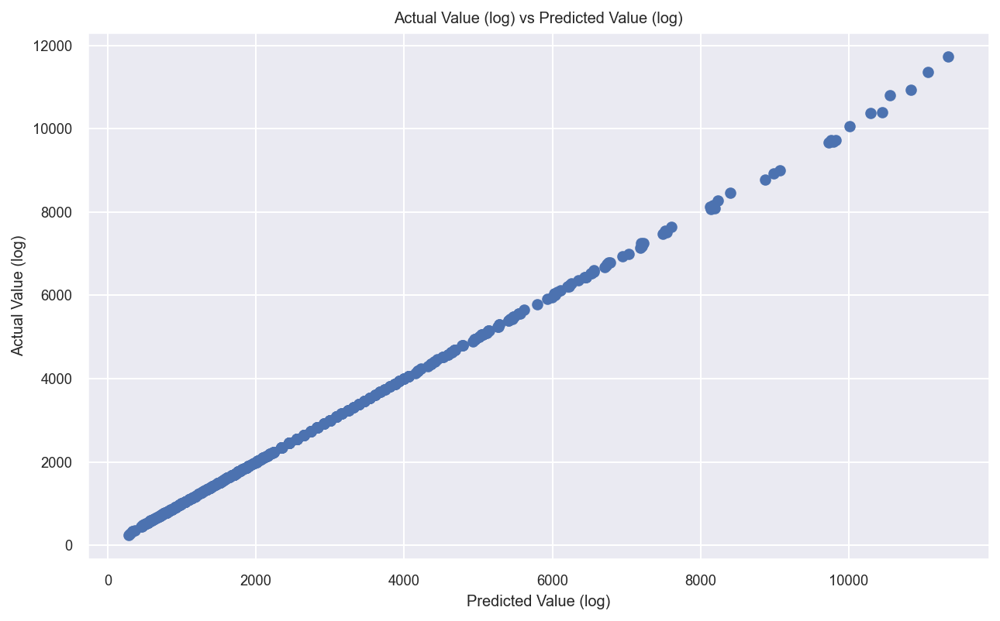

In [1307]:
plt.figure(figsize=(10,6),dpi=150),
rfr_model = RandomForestRegressor()
fit = rfr_model.fit(X_test_arr,y_test);
pred =rfr_model.predict(X_test_arr)
plt.scatter(pred,y_test)
plt.title("Actual Value (log) vs Predicted Value (log)")
plt.xlabel("Predicted Value (log)")
plt.ylabel("Actual Value (log)")
plt.show()

### Gradient Boosting (cross validation and hyperparameter tuning)

In [1455]:
#cross validation
gb = GradientBoostingRegressor()
kf = KFold(n_splits=10, shuffle=True, random_state = 10)
cross_val_score(lr, X_train_arr, y_train, cv=kf, scoring='r2')

print(round(np.mean(cross_val_score(gb, X_train_arr, y_train.values.ravel(), cv=kf, scoring='r2')),5))

0.99861


In [1456]:
params_gb = {'learning_rate' : [0.1, 0.01, 0.001], 'n_estimators' : [50, 100, 200],
           'subsample' : [0.8, 0.9, 1.0], 'min_samples_split' : [0.01, 0.001],
           'max_depth' : [3, 5, 8], 'max_features' : ['auto', 'sqrt', 'log2'],
          }
rsearch_gb = RandomizedSearchCV(gb, params_gb, cv=10, n_iter=10, n_jobs=10, scoring='r2', verbose=True, random_state=42)



In [1457]:
rsearch_gb.fit(X_train_arr, y_train.values.ravel())

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomizedSearchCV(cv=10, estimator=GradientBoostingRegressor(), n_jobs=10,
                   param_distributions={'learning_rate': [0.1, 0.01, 0.001],
                                        'max_depth': [3, 5, 8],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_split': [0.01, 0.001],
                                        'n_estimators': [50, 100, 200],
                                        'subsample': [0.8, 0.9, 1.0]},
                   random_state=42, scoring='r2', verbose=True)

In [1458]:
pd.DataFrame(rsearch_gb.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

,mean_test_score,std_test_score,params
0,0.272760,0.017344,"{'subsample': 0.8, 'n_estimators': 200, 'min_s..."
1,0.554681,0.021386,"{'subsample': 0.9, 'n_estimators': 50, 'min_sa..."
2,0.273439,0.018774,"{'subsample': 1.0, 'n_estimators': 200, 'min_s..."
3,0.315820,0.013601,"{'subsample': 0.9, 'n_estimators': 200, 'min_s..."
4,0.122580,0.019200,"{'subsample': 0.9, 'n_estimators': 100, 'min_s..."
5,0.293123,0.015712,"{'subsample': 0.8, 'n_estimators': 200, 'min_s..."
6,0.757376,0.025065,"{'subsample': 0.9, 'n_estimators': 100, 'min_s..."
7,0.622876,0.010356,"{'subsample': 0.8, 'n_estimators': 50, 'min_sa..."
8,0.973214,0.011341,"{'subsample': 1.0, 'n_estimators': 100, 'min_s..."
9,0.859549,0.009551,"{'subsample': 0.9, 'n_estimators': 100, 'min_s..."


In [1459]:
rsearch_gb.best_score_

0.9732135690164055

In [1460]:
rsearch_gb.best_estimator_

GradientBoostingRegressor(max_depth=5, max_features='log2',
                          min_samples_split=0.001)

In [1461]:
rsearch_gb.best_params_

{'subsample': 1.0,
 'n_estimators': 100,
 'min_samples_split': 0.001,
 'max_features': 'log2',
 'max_depth': 5,
 'learning_rate': 0.1}

## Final Model (Gradient Boosting) Model: Prediction on Training and Test data<br>(With popularity data and wage) 

In [1462]:
gbm_model=GradientBoostingRegressor(max_depth=5, max_features='log2',
                          min_samples_split=0.001, n_estimators=100)

In [1463]:
gbm_model.fit(X_train_arr, y_train.values.ravel())


GradientBoostingRegressor(max_depth=5, max_features='log2',
                          min_samples_split=0.001)

#### Prediction on Training data

In [1464]:
print("Training")
print_metrics(gbm_model, X_train_arr, y_train)

Training
Mean Squared error : 3618.3142915316735
Mean Absolute error : 46.765435134179945
R2 Score: 0.999120318207964


#### Prediction on Testing data

In [1465]:
print("Testing")
print_metrics(gbm_model, X_test_arr, y_test[labels])

Testing
Mean Squared error : 111448.49397947296
Mean Absolute error : 162.65296704155833
R2 Score: 0.9661760549660631


/Users/swapnilsrivastava/Documents/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



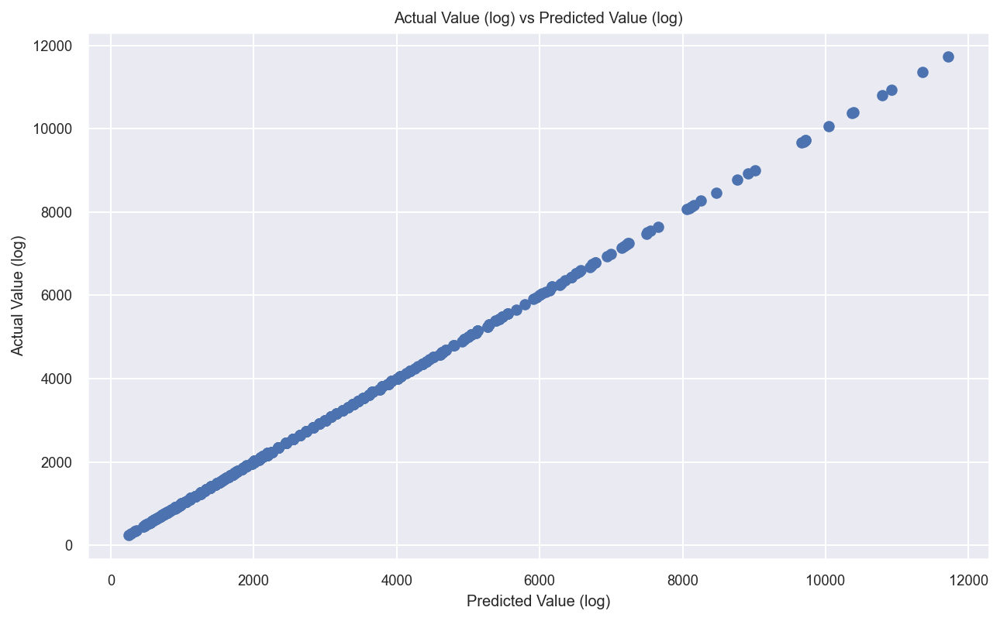

In [1311]:
plt.figure(figsize=(10,6),dpi=150),
gbm_model = GradientBoostingRegressor()
fit = gbm_model.fit(X_test_arr,y_test);
pred =gbm_model.predict(X_test_arr)
plt.scatter(pred,y_test)
plt.title("Actual Value (log) vs Predicted Value (log)")
plt.xlabel("Predicted Value (log)")
plt.ylabel("Actual Value (log)")
plt.show()

# Result: Gradient boosting model (with popularity and wage data) is the best performing model 

In [1466]:
feature_importance(gbm_model)



[('wage_avg', 0.28746397079816577),
 ('potential', 0.17466258986106384),
 ('rf', 0.10597366486054235),
 ('overall', 0.06422177901247046),
 ('rs2', 0.04025693385348068),
 ('international_reputation', 0.03872911901033915),
 ('rw', 0.03473780380343914),
 ('wage_eur', 0.03168191528757634),
 ('lb2', 0.02892198890989762),
 ('cf', 0.020535167474447242),
 ('rcm1', 0.019648649462083983),
 ('lcb2', 0.016978320345456),
 ('dribbling_new', 0.0133556489296501),
 ('lf', 0.011862118584383966),
 ('lw', 0.011274014060839553),
 ('sofifa_id', 0.009311887037444191),
 ('cm1', 0.007405502887614846),
 ('passing_new', 0.0068911961971581505),
 ('pace_new', 0.006825127014422308),
 ('defending_new', 0.0065586385745978045),
 ('lcm1', 0.0065570330789789175),
 ('x3_Unique', 0.006171770412026631),
 ('rwb2', 0.00605676251843968),
 ('physical_new', 0.005279522732742539),
 ('age', 0.005256148946038295),
 ('ls1', 0.0038452594717125785),
 ('weight_kg', 0.0031282723077251974),
 ('club_team_id', 0.0028988542252219554),
 ('s